# Map Zone Labelling

**Goals**:
- map zone labels
- remove some low quality cells

---

**ATTENTION**:
- mapping heppens for a single cell type: need to have all cells of a spefic cell type and get zone lebels for them (thus use a the corresponding cell type reference)
- Query must:
    - have same gene names --> "gene symbols" (not ensamble id)
    - be .h5ad
    - have raw counts in .X
- outputs
    - recomputed_stats.h5: Reference statistics per cell type
    - reference_markers.h5: Marker genes for reference cell types
q   - query_markers.json: Selected markers for query mapping ("markers useful for querying" not "based on a specific query dataset.")
    - **mapping_output.csv**: CSV table with:
        - Cell barcodes/IDs
        - Predicted cell type labels
        - Confidence/probability scores

Remember to download the mapping h5ad of referece datets:
```bash
    gsutil cp /broad/macosko/leematth/projects/zonation/akraft_new_objs/processed/STR_D1_Matrix_MSN.h5ad  . 
```

The script to run mapmycell on this dataset works by:
- Computing statistics from a reference (annotated) dataset
- Finding marker genes
- Mapping query cells to reference cell types using those markers

In [1]:
%load_ext autoreload
%autoreload 2


# MUST BE FIRST - before any imports from cell_type_mapper --> error if FromSpecifiedMarkersRunner run wiht GPU
import os
os.environ['CUDA_VISIBLE_DEVICES'] = ''

import pandas as pd
import scanpy as sc
import os
from dotenv import load_dotenv; load_dotenv()
import ipynbname
import shutil
import numpy as np
import matplotlib.pyplot as plt
import json
from tqdm.notebook import tqdm
import subprocess


from utils import preprocessing


# Hyperparamyters
BASE_PATH = os.getenv("BASE_PATH_FOR_SAVING")
DISEASE_TYPE = "diseased" # diseased / healthy
SAMPLE_ID = "recon_241105" #"sample_01" #"recon_241105"

ADATA_PATH = f'{BASE_PATH}/{DISEASE_TYPE}/{SAMPLE_ID}/adata/all_lib_adata.h5ad' #"/home/gdallagl/myworkdir/XDP/data/XDP/diseased/recon_241105/FAKE_BCL/FAKE_LIBRARY/adata/reprocessed_filtered_adata.h5ad" #f'{BASE_PATH}/{DISEASE_TYPE}/{SAMPLE_ID}/adata/all_lib_adata.h5ad'
MAPPING_OUTPUT_FOLDER =  f'{BASE_PATH}/{DISEASE_TYPE}/{SAMPLE_ID}/zoning'

ZONE_LABELLING_SCRIPT = os.getenv("ZONE_LABELLING_SCRIPT")
ZONE_LABELLING_REFERENCES_FOLDER = os.getenv("ZONE_LABELLING_REFERENCES_FOLDER")
ZONE_LABELLING_STAT_FOLDER = f"{ZONE_LABELLING_REFERENCES_FOLDER}/stats"

ZONE_LABELS_COL_NAME_IN_REF = "D1_zones_6_assigned_v2" #ATTENTION: must be the same of the mapping scirpt

GROUP_LEVEL_CT_MAKE_D1_MATRIX = ["STRd D1 Matrix MSN", "STRv D1 MSN"] # cell type of map my cell that make up the matrix D1 cells
GROUP_LEVEL_CT_MAKE_D2_MATRIX = ["STRd D2 Matrix MSN", "STRv D2 MSN"]

CT_REFERENCE_NAME = "STR_D1_Matrix_MSN"  # Reference h5ad filename (without .h5ad) used for mapping this cell type (D1 Matrix)
QUERY_CT_ANNOTATION = "my_grouping_for_zoning" # Obs col with cell type to investage (IT IS A NEW GROUPING!!!)
CT_QUERY_NAME = "STR D1 Matrix MSN"       # Cell type name in query.obs[QUERY_CT_ANNOTATION] (ie how D1 MAtrix neurons are called)

OBS_COL_ZONE = "zone" # col where zone will be saved

# Load Query


In [2]:
query = sc.read_h5ad(ADATA_PATH)
print(query)

AnnData object with n_obs × n_vars = 126494 × 36190
    obs: 'total_counts', 'n_genes', 'logumi', 'pct_counts_mt', 'seurat_clusters', 'x', 'y', 'library', 'cell_class', 'cell_subclass', 'reclustered_patch_matrix_exotic', 'has_spatial', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Neighborhood_aggregate_probability', 'Neighborhood_correlation_coefficient', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Class_aggregate_probability', 'Class_correlation_coefficient', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Subclass_aggregate_probability', 'Subclass_correlation_coefficient', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Group_aggregate_probability', 'Group_correlation_coefficient', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Cluster_aggregate_probability', 'Cluster_correlation_coefficient', 'pct_intronic', 'is_cell', 'n_genes_by_counts',

In [3]:
# Create spatial matrix with NaN by default
spatial_coords = np.full((query.n_obs, 2), np.nan)
# For cells with has_spatial == True, add their real coordinates
mask = query.obs['has_spatial'] == True
spatial_coords[mask] = query.obs.loc[mask, ['x', 'y']].values
# Assign to obsm
query.obsm['spatial'] = spatial_coords

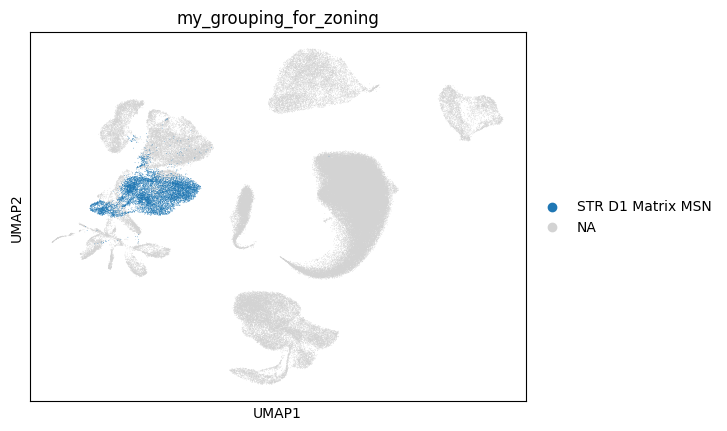

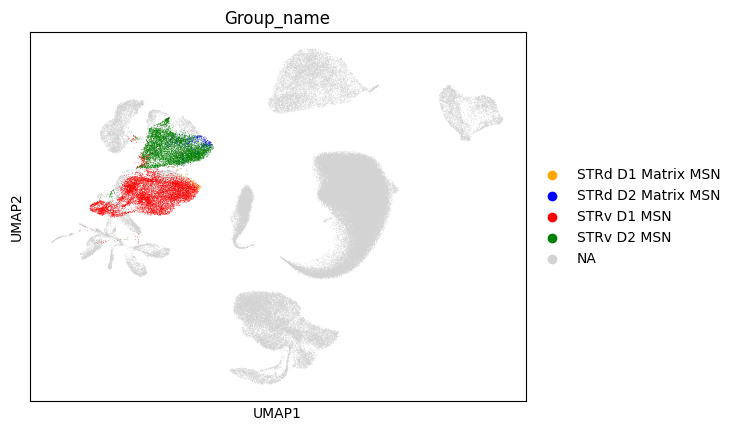

In [4]:
# add col to tell if cell is D1 matrix
query.obs[QUERY_CT_ANNOTATION] = [CT_QUERY_NAME if i else np.nan for i in query.obs.Group_name.isin(GROUP_LEVEL_CT_MAKE_D1_MATRIX)]

sc.pl.umap(query, color=QUERY_CT_ANNOTATION)
sc.pl.umap(query, color="Group_name", groups=[*GROUP_LEVEL_CT_MAKE_D1_MATRIX, *GROUP_LEVEL_CT_MAKE_D2_MATRIX], palette=["red", "blue", "green", "orange"])

# Create and save tmp query

<pre>
project/
│
├── ZONE_LABELLING_REFERENCES_FOLDER/
│   ├── ct_zoning_1.h5ad
│   ├── ct_zoning_2.h5ad
│   ├── ...
│   │
│   └── ZONE_LABELLING_STAT_FOLDER/
│       │
│       ├── ct_zoning_1/                      # Working directory per reference
│       │   ├── ct_mmc_*.h5ad                 # ⚠ Overwrites each run (Query h5ad)
│       │   ├── precomputed_stats.h5          # ✓ Reusable across queries (independent of query)
│       │   ├── reference_markers.h5          # ✓ Reusable across queries (independent of query)
│       │   ├── query_markers.json            # ✓ Reusable across queries (independent of query)
│       │   ├── mapping_output.csv            # ⚠ Overwrites each run (ie, the query is different but for this ct_zoning cell type)
│       │   └── mapping_output.json           # ⚠ Overwrites each run (ie, the query is different but for this ct_zoning cell type)
│       │
│       ├── ct_zoning_2/
│       │   └── ...
│       └── ...
│
└── MAPPING_OUTPUT_FOLDER/
    │
    ├── ct_mmc_1/                             # Final results per query cell type
    │   ├── mapping_output.csv                # ✓ Preserved copy
    │   └── mapping_output.json               # ✓ Preserved copy
    │
    ├── ct_mmc_2/
    │   ├── mapping_output.csv
    │   └── mapping_output.json
    └── ...

</pre>


### Set up paths

In [5]:
# Create formatted name for file paths
ct_formatted = CT_QUERY_NAME.replace(" ", "_") # no spaces in path

# Define all paths
working_folder = os.path.join(ZONE_LABELLING_STAT_FOLDER, CT_REFERENCE_NAME)
output_folder = os.path.join(MAPPING_OUTPUT_FOLDER, ct_formatted)
ref_path = os.path.join(ZONE_LABELLING_REFERENCES_FOLDER, f"{CT_REFERENCE_NAME}.h5ad")
query_path = os.path.join(working_folder, f"{ct_formatted}.h5ad")

# Create directories
os.makedirs(working_folder, exist_ok=True)
os.makedirs(output_folder, exist_ok=True)

print(f"Reference:      {ref_path}")
print(f"Query will be:  {query_path}")
print(f"Working folder: {working_folder}")
print(f"Final output:   {output_folder}")

Reference:      /home/gdallagl/myworkdir/data/STR_zonation_references_h5ad/STR_D1_Matrix_MSN.h5ad
Query will be:  /home/gdallagl/myworkdir/data/STR_zonation_references_h5ad/stats/STR_D1_Matrix_MSN/STR_D1_Matrix_MSN.h5ad
Working folder: /home/gdallagl/myworkdir/data/STR_zonation_references_h5ad/stats/STR_D1_Matrix_MSN
Final output:   /home/gdallagl/myworkdir/data/XDP/diseased/recon_241105/zoning/STR_D1_Matrix_MSN


### Subset Query Data

Need to map spetiic cell type to petrici cell type ref


Cell type to map: STR D1 Matrix MSN


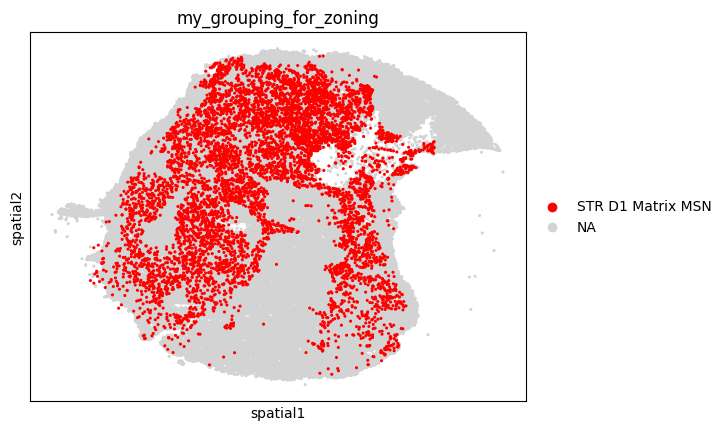


Subsetting to STR D1 Matrix MSN cells...
  Found 8759 cells


In [6]:
# Visualize cells to map
print(f"\nCell type to map: {CT_QUERY_NAME}")
sc.pl.embedding(query, basis="spatial", color=QUERY_CT_ANNOTATION,  # use grouping made by me
                groups=[CT_QUERY_NAME], size=20, palette=["red"])

# Subset to cells of interest
print(f"\nSubsetting to {CT_QUERY_NAME} cells...")
adata_ct = query[query.obs[QUERY_CT_ANNOTATION] == CT_QUERY_NAME].copy()
print(f"  Found {adata_ct.n_obs} cells")

### Format adata to work with MMC script
- raw counts in .X
- same gene names as ref

In [7]:
# Create minimal AnnData with only what's needed for mapping
adata_minimal = sc.AnnData(
    X=adata_ct.layers["counts"],                      # Raw counts required
    obs=pd.DataFrame(index=adata_ct.obs_names),       # Just cell IDs
    var=pd.DataFrame(index=adata_ct.var["gene_symbol"])  # Gene symbols as index
)

# Save
adata_minimal.write(query_path)
print(f"✓ Saved to: {query_path}\n")

✓ Saved to: /home/gdallagl/myworkdir/data/STR_zonation_references_h5ad/stats/STR_D1_Matrix_MSN/STR_D1_Matrix_MSN.h5ad



### Verify Ref

In [8]:
ref = sc.read_h5ad(ref_path, backed="r")

# Has mapping col
print(f"  Has '{ZONE_LABELS_COL_NAME_IN_REF}': {ZONE_LABELS_COL_NAME_IN_REF in ref.obs.columns}")

# Check gene overlap
query_genes = set(adata_ct.var["gene_symbol"])
ref_genes = set(ref.var_names)
overlap = len(query_genes.intersection(ref_genes)) / len(ref_genes)
print(f"  Gene overlap: {overlap:.1%}")

  Has 'D1_zones_6_assigned_v2': True
  Gene overlap: 94.8%


# Run bash command for mapping

In [9]:
!chmod +x {ZONE_LABELLING_SCRIPT}

In [10]:

cmd = [
    ZONE_LABELLING_SCRIPT,
    "-r", ref_path,
    "-q", query_path,
    "-o", working_folder
    # "-c" # Without -c: Do not recalculate the existing files, but the final mapping csv is recalucted 
]
    
print("Running mapping script...")
print(" ".join(cmd))

result = subprocess.run(cmd, capture_output=True, text=True) # Waits for script to complete (blocks until done)

# Print output
if result.returncode != 0:
    print("ATTNETION: Mapping failed!")
    print(result.stderr)
    raise RuntimeError("Mapping script failed")

print(result.stdout)
print("Mapping complete")




# Copy results to final folder
print("\nCopying results...")
import shutil

shutil.copy2(
    os.path.join(working_folder, "mapping_output.csv"),
    os.path.join(output_folder, "mapping_output.csv")
)
shutil.copy2(
    os.path.join(working_folder, "mapping_output.json"),
    os.path.join(output_folder, "mapping_output.json")
)

print(f"Results saved to: {output_folder}")


Running mapping script...
/home/gdallagl/myworkdir/XDP/utils/STR_cell_types_annotation/run_mapmycells_zones.sh -r /home/gdallagl/myworkdir/data/STR_zonation_references_h5ad/STR_D1_Matrix_MSN.h5ad -q /home/gdallagl/myworkdir/data/STR_zonation_references_h5ad/stats/STR_D1_Matrix_MSN/STR_D1_Matrix_MSN.h5ad -o /home/gdallagl/myworkdir/data/STR_zonation_references_h5ad/stats/STR_D1_Matrix_MSN
/home/gdallagl/myworkdir/data/STR_zonation_references_h5ad
make output directory
Reference Directory: /home/gdallagl/myworkdir/data/STR_zonation_references_h5ad
Query Directory: /home/gdallagl/myworkdir/data/STR_zonation_references_h5ad/stats/STR_D1_Matrix_MSN/STR_D1_Matrix_MSN.h5ad
Output Directory: /home/gdallagl/myworkdir/data/STR_zonation_references_h5ad/stats/STR_D1_Matrix_MSN
get precomputed stats
finally process 455084 tot 1.20e+01 reading 1.33e+00 writing 2.84e-02
finally process 455082 tot 3.03e+01 reading 3.37e+00 writing 4.71e-02
finally process 455083 tot 3.02e+01 reading 3.36e+00 writing 4

# Add labels to adata

In [11]:
# Read mapping results
mapping_df = pd.read_csv(
    os.path.join(output_folder, "mapping_output.csv"), 
    comment="#"
)
mapping_df.set_index("cell_id", inplace=True)

print(f"Loaded mapping for {len(mapping_df)} cells")

# Define source and target column names
source_zone_col = f"{ZONE_LABELS_COL_NAME_IN_REF}_name" # defined in script
source_prob_col = f"{ZONE_LABELS_COL_NAME_IN_REF}_bootstrapping_probability"

target_zone_col = OBS_COL_ZONE  # "zone"
target_prob_col = f"{OBS_COL_ZONE}_probability"  # "zone_probability"

# Initialize columns if they don't exist
if target_zone_col not in query.obs.columns:
    query.obs[target_zone_col] = np.nan
if target_prob_col not in query.obs.columns:
    query.obs[target_prob_col] = np.nan

# Find matching cells
common_cells = query.obs_names.intersection(mapping_df.index)

# Add zone labels
query.obs.loc[common_cells, target_zone_col] = mapping_df.loc[common_cells, source_zone_col].values

# Add probability scores
query.obs.loc[common_cells, target_prob_col] = mapping_df.loc[common_cells, source_prob_col].values

# Convert zone to categorical
query.obs[target_zone_col] = pd.Categorical(
    query.obs[target_zone_col].astype("Int64")
)

Loaded mapping for 8759 cells


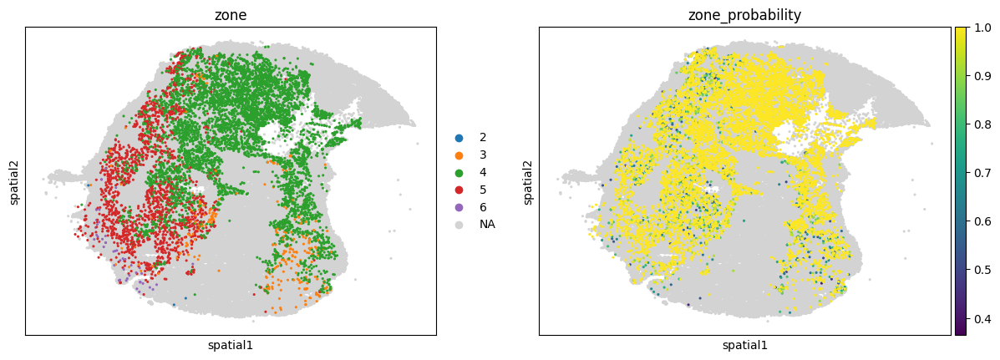

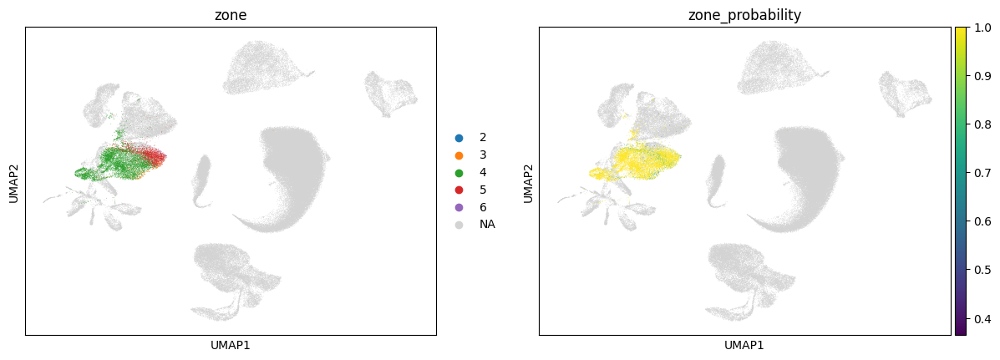

In [12]:
# Visualize results
sc.pl.embedding(query, basis="spatial", color=[target_zone_col, target_prob_col], size=20)
sc.pl.umap(query, color=[target_zone_col, target_prob_col])

# Remove low quality cells

Attention to not remove diseased cells (ex zone 1, 6)

## Intial phase before filtering

process at differt level to be sure to not remvoe important cells.

### All Neurons

In [13]:
# # Load the JSON file
# with open(os.getenv("GROUP_LEVEL_MMC_MAPPING_PATH"), 'r') as f:
#     classifications = json.load(f)
# palette_ct = classifications["group_level_celltype_colors"]
# #neurons_cts = list(classifications["category_only_neurons"].keys())

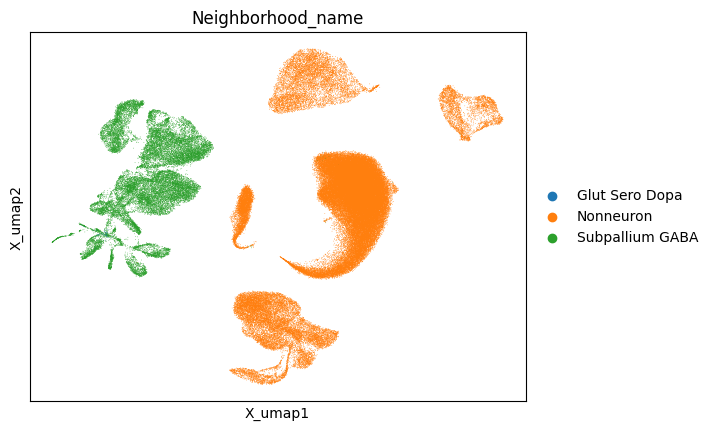

In [14]:
sc.pl.embedding(query, basis='X_umap', color="Neighborhood_name", size=1)


In [15]:
query_only_neurons = query[query.obs.Neighborhood_name.isin(["Glut Sero Dopa", "Subpallium GABA"])].copy()
print(query_only_neurons)

# bring back counts to X
query_only_neurons.X = query_only_neurons.layers["counts"]
query_only_neurons.obsm["all_cells_old_umap"] = query_only_neurons.obsm["X_umap"].copy()
query_only_neurons.obsm["all_cells_old_pca"] = query_only_neurons.obsm["X_pca"].copy()



# Filter genes
print(f"   Genes before filtering: {query_only_neurons.n_vars}")
sc.pp.filter_genes(query_only_neurons, min_cells=3)
print(f"   Genes after filtering: {query_only_neurons.n_vars}")

# reprocess
preprocessing.preprocess(query_only_neurons, n_pcs_elbow=30, n_hvg=3000, verbose=False)

AnnData object with n_obs × n_vars = 27461 × 36190
    obs: 'total_counts', 'n_genes', 'logumi', 'pct_counts_mt', 'seurat_clusters', 'x', 'y', 'library', 'cell_class', 'cell_subclass', 'reclustered_patch_matrix_exotic', 'has_spatial', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Neighborhood_aggregate_probability', 'Neighborhood_correlation_coefficient', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Class_aggregate_probability', 'Class_correlation_coefficient', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Subclass_aggregate_probability', 'Subclass_correlation_coefficient', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Group_aggregate_probability', 'Group_correlation_coefficient', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Cluster_aggregate_probability', 'Cluster_correlation_coefficient', 'pct_intronic', 'is_cell', 'n_genes_by_counts', 

/home/gdallagl/.pyenv/versions/3.11.8/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


Calculating PCA...
Calculating neighbors...
Calculating Umap...
Clutering...
Preprocessing done.


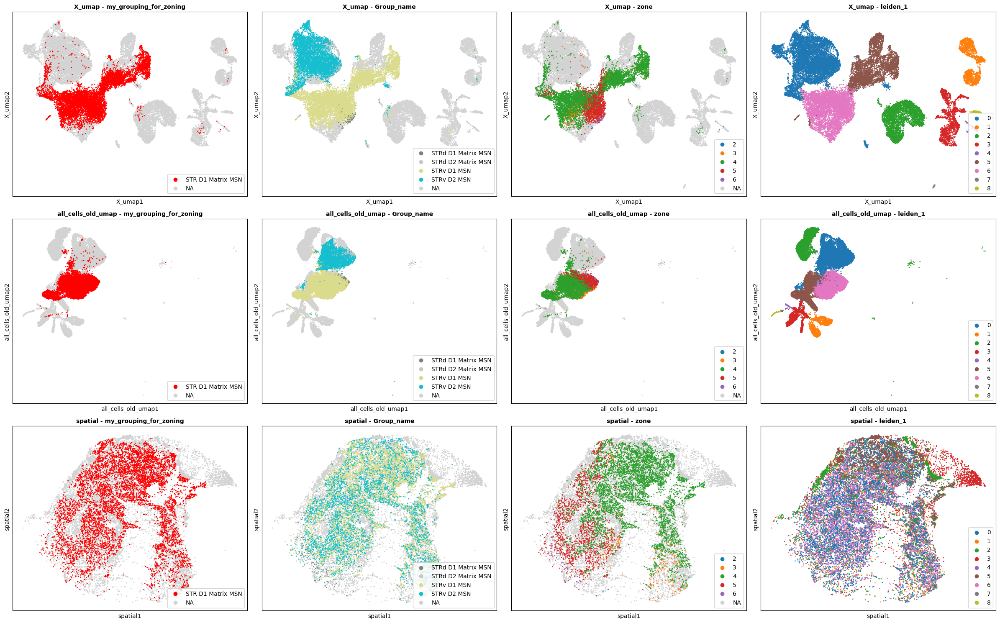

In [63]:
def plot_embedding_grid(adata, bases, colors, highlight_groups=None, size=10, figsize=None):
    
    import matplotlib.pyplot as plt
    
    n_rows = len(bases)
    n_cols = len(colors)
    
    # Auto-calculate figure size if not provided
    if figsize is None:
        figsize = (6*n_cols, 5*n_rows)
    
    fig, axs = plt.subplots(n_rows, n_cols, figsize=figsize)
    
    # Handle single row/col case
    if n_rows == 1 and n_cols == 1:
        axs = np.array([[axs]])
    elif n_rows == 1:
        axs = axs.reshape(1, -1)
    elif n_cols == 1:
        axs = axs.reshape(-1, 1)
    
    # Plot each combination
    for i, basis in enumerate(bases):
        for j, color in enumerate(colors):
            
            # Get groups to highlight (if any)
            groups = highlight_groups.get(color, None) if highlight_groups else None
            
            # Plot
            sc.pl.embedding(
                adata,
                basis=basis,
                color=color,
                groups=groups,
                size=size,
                ax=axs[i, j],
                show=False,
                legend_loc="lower right"
            )
            
            # Title
            axs[i, j].set_title(f"{basis} - {color}", fontsize=10, fontweight='bold')
    
    plt.tight_layout()
    plt.show()

plot_embedding_grid(
    adata=query_only_neurons,
    bases=['X_umap', 'all_cells_old_umap', 'spatial'],
    colors=[QUERY_CT_ANNOTATION, "Group_name", OBS_COL_ZONE, "leiden_1"],
    highlight_groups={
        "Group_name": [*GROUP_LEVEL_CT_MAKE_D1_MATRIX, *GROUP_LEVEL_CT_MAKE_D2_MATRIX]
    },
    size=15
)

## Filter really outliers

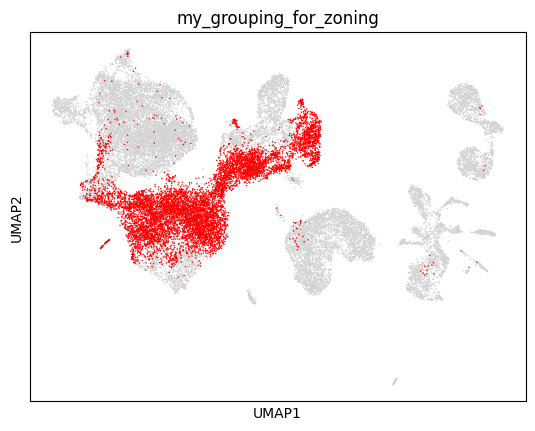

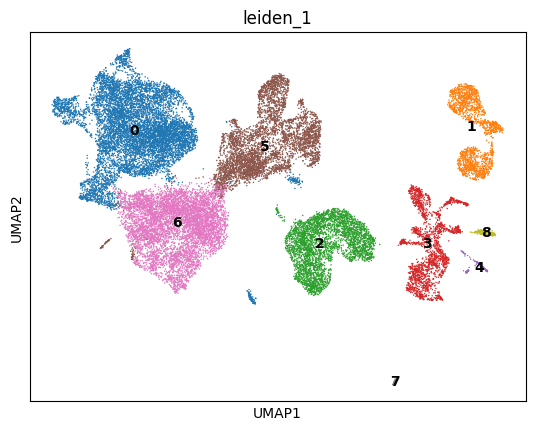

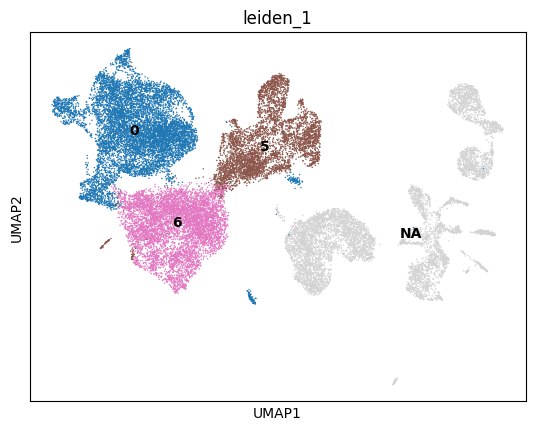

In [75]:
LEIDEN = "leiden_1"
ONLY_D1_D2_CLUSTERS = ["0", "5", "6"]
QUERY_CT_ANNOTATION
sc.pl.umap(query_only_neurons, color=QUERY_CT_ANNOTATION, legend_loc=None)
sc.pl.umap(query_only_neurons, color="leiden_1", legend_loc="on data")
sc.pl.umap(query_only_neurons, color="leiden_1", legend_loc="on data", groups=ONLY_D1_D2_CLUSTERS)

In [78]:
# Filter 
cells_to_keep = query_only_neurons[query_only_neurons.obs[LEIDEN].isin(ONLY_D1_D2_CLUSTERS)].obs.index
query_only_neurons._inplace_subset_obs(cells_to_keep)

### Only D1 D2 Matrix

In [79]:
query_only_neurons_D1_D2_matrix = query_only_neurons[query_only_neurons.obs.Group_name.isin(
    [*GROUP_LEVEL_CT_MAKE_D1_MATRIX, *GROUP_LEVEL_CT_MAKE_D2_MATRIX]
    )].copy() 

print(query_only_neurons_D1_D2_matrix)

# bring back counts to X
query_only_neurons_D1_D2_matrix.X = query_only_neurons_D1_D2_matrix.layers["counts"]
query_only_neurons_D1_D2_matrix.obsm["only_neurons_old_umap"] = query_only_neurons_D1_D2_matrix.obsm["X_umap"].copy()
query_only_neurons_D1_D2_matrix.obsm["only_neurons_old_pca"] = query_only_neurons_D1_D2_matrix.obsm["X_pca"].copy()
query_only_neurons_D1_D2_matrix.obsp["only_neurons_old_connectivities"] = query_only_neurons_D1_D2_matrix.obsp["connectivities"].copy()
query_only_neurons_D1_D2_matrix.obsp["only_neurons_old_distances"] = query_only_neurons_D1_D2_matrix.obsp["distances"].copy()


# Filter genes
print(f"   Genes before filtering: {query_only_neurons_D1_D2_matrix.n_vars}")
sc.pp.filter_genes(query_only_neurons_D1_D2_matrix, min_cells=3)
print(f"   Genes after filtering: {query_only_neurons_D1_D2_matrix.n_vars}")

# reprocess
preprocessing.preprocess(query_only_neurons_D1_D2_matrix, n_pcs_elbow=30, n_hvg=3000, verbose=False)


AnnData object with n_obs × n_vars = 15594 × 35254
    obs: 'total_counts', 'n_genes', 'logumi', 'pct_counts_mt', 'seurat_clusters', 'x', 'y', 'library', 'cell_class', 'cell_subclass', 'reclustered_patch_matrix_exotic', 'has_spatial', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Neighborhood_aggregate_probability', 'Neighborhood_correlation_coefficient', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Class_aggregate_probability', 'Class_correlation_coefficient', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Subclass_aggregate_probability', 'Subclass_correlation_coefficient', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Group_aggregate_probability', 'Group_correlation_coefficient', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Cluster_aggregate_probability', 'Cluster_correlation_coefficient', 'pct_intronic', 'is_cell', 'n_genes_by_counts', 

/home/gdallagl/.pyenv/versions/3.11.8/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


Calculating PCA...
Calculating neighbors...
Calculating Umap...
Clutering...
Preprocessing done.


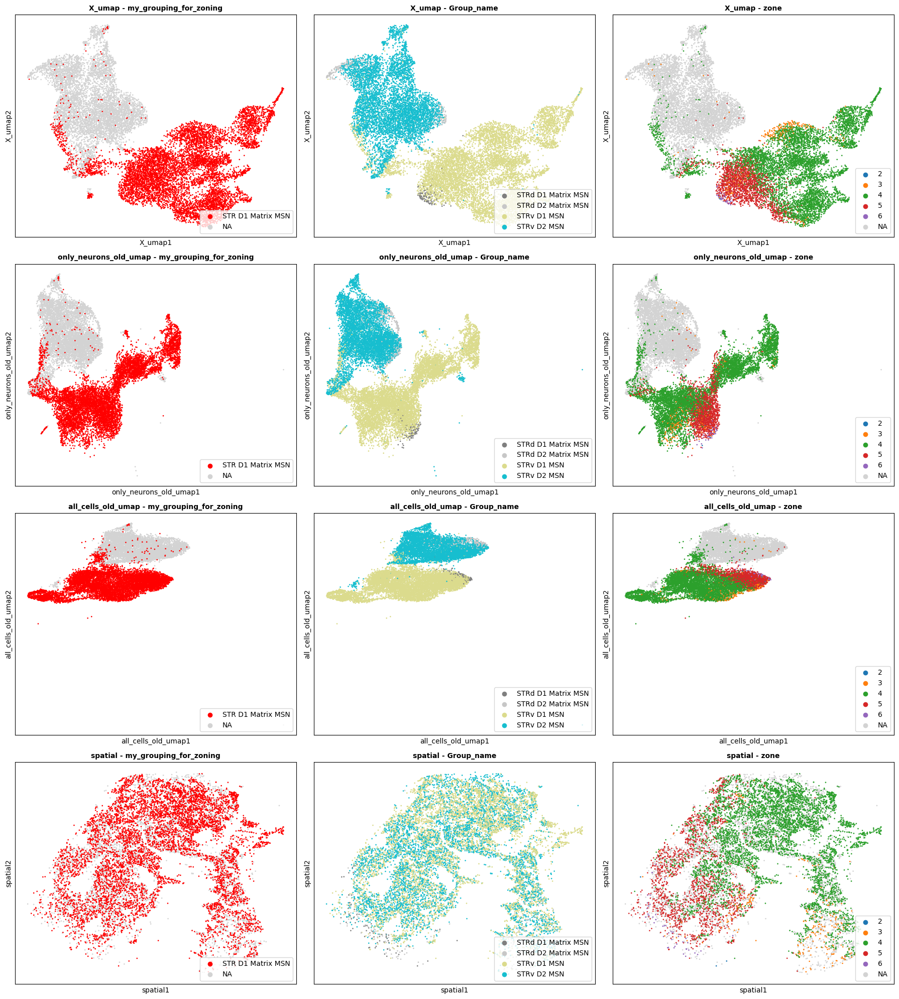

In [80]:
plot_embedding_grid(
    adata=query_only_neurons_D1_D2_matrix,
    bases=['X_umap', 'only_neurons_old_umap', 'all_cells_old_umap', 'spatial'],
    colors=[QUERY_CT_ANNOTATION, "Group_name", OBS_COL_ZONE],
    highlight_groups={
        "Group_name": [*GROUP_LEVEL_CT_MAKE_D1_MATRIX, *GROUP_LEVEL_CT_MAKE_D2_MATRIX]
    },
    size=15
)

### Only D1 Matrix

In [81]:
query_D1_matrix = query_only_neurons_D1_D2_matrix[query_only_neurons_D1_D2_matrix.obs.Group_name.isin(
    [*GROUP_LEVEL_CT_MAKE_D1_MATRIX]
    )].copy() 
print(query_D1_matrix)

# bring back counts to X
query_D1_matrix.X = query_D1_matrix.layers["counts"]
query_D1_matrix.obsm["only_D1_D2_old_umap"] = query_D1_matrix.obsm["X_umap"].copy()
query_D1_matrix.obsm["only_D1_D2_old_pca"] = query_D1_matrix.obsm["X_pca"].copy()


# Filter genes
print(f"   Genes before filtering: {query_D1_matrix.n_vars}")
sc.pp.filter_genes(query_D1_matrix, min_cells=3)
print(f"   Genes after filtering: {query_D1_matrix.n_vars}")

# reprocess
preprocessing.preprocess(query_D1_matrix, n_pcs_elbow=30, n_hvg=3000, verbose=False)


AnnData object with n_obs × n_vars = 8711 × 33781
    obs: 'total_counts', 'n_genes', 'logumi', 'pct_counts_mt', 'seurat_clusters', 'x', 'y', 'library', 'cell_class', 'cell_subclass', 'reclustered_patch_matrix_exotic', 'has_spatial', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Neighborhood_aggregate_probability', 'Neighborhood_correlation_coefficient', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Class_aggregate_probability', 'Class_correlation_coefficient', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Subclass_aggregate_probability', 'Subclass_correlation_coefficient', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Group_aggregate_probability', 'Group_correlation_coefficient', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Cluster_aggregate_probability', 'Cluster_correlation_coefficient', 'pct_intronic', 'is_cell', 'n_genes_by_counts', '

/home/gdallagl/.pyenv/versions/3.11.8/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


Calculating PCA...
Calculating neighbors...
Calculating Umap...
Clutering...
Preprocessing done.


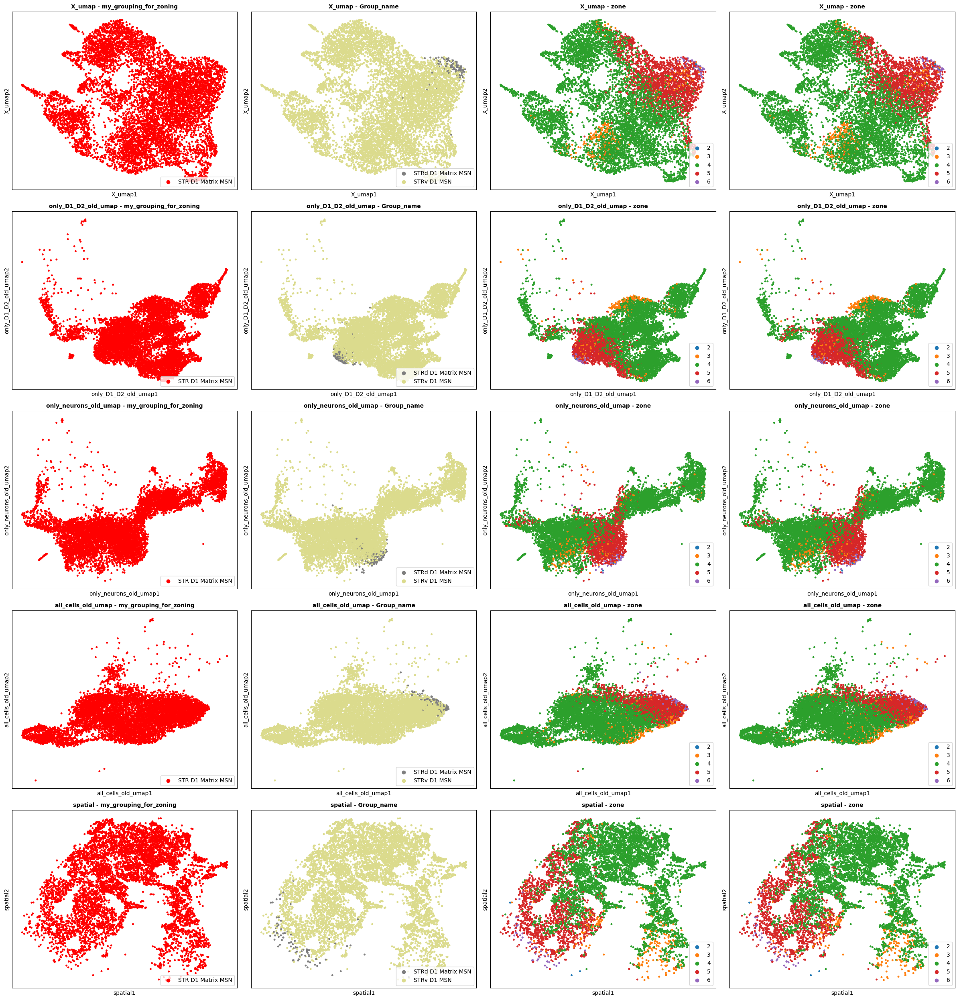

In [82]:
plot_embedding_grid(
    adata=query_D1_matrix,
    bases=['X_umap', 'only_D1_D2_old_umap', 'only_neurons_old_umap', 'all_cells_old_umap', 'spatial'],
    colors=[QUERY_CT_ANNOTATION, "Group_name", OBS_COL_ZONE, "zone"],
    highlight_groups={
        "Group_name": [*GROUP_LEVEL_CT_MAKE_D1_MATRIX, *GROUP_LEVEL_CT_MAKE_D2_MATRIX]
    },
    size=50
)

## Based on scattered cells (noise)

remvoe neurosn that are far away form toehr (present in other cell types).

Use as distces, umap of "only neruons".

Avodu rto remvoe dorsal depleted populations: 1,2,6

In [21]:
# # Calculate connectivity (total connections per cell)
# conn = query_D1_matrix.obsp[
#     "only_neurons_old_connectivities"
# ].sum(axis=1).A1

# is_protected = query_D1_matrix.obs["zone"].isin([1,2,6])


# # Keep cells with low mean distance (in dense regions)
# threshold = 2 #np.percentile(mean_dist, 90)  # Remove top 10% most isolated
# print(threshold)
# isolated_cells = conn <= threshold

# query_D1_matrix.obs["is_noise"] = ["True" if (isolated & ~fragile_zone) else np.nan for isolated, fragile_zone in zip(isolated_cells, is_protected)]
    
# print(query_D1_matrix.obs["is_noise"].value_counts())

# display(
#     pd.crosstab(
#         query_D1_matrix.obs["is_noise"],
#         query_D1_matrix.obs["zone"], 
#         dropna=False
#     )
# )


# plot_embedding_grid(
#     adata=query_D1_matrix,
#     bases=['X_umap', 'only_D1_D2_old_umap', 'only_neurons_old_umap', 'all_cells_old_umap', 'spatial'],
#     colors=["zone", "leiden_2", 'is_noise'],
#     highlight_groups={
#         "Group_name": [*GROUP_LEVEL_CT_MAKE_D1_MATRIX, *GROUP_LEVEL_CT_MAKE_D2_MATRIX]
#     },
#     size=50
# )

In [22]:
# # filter
# query_D1_matrix = query_D1_matrix[query_D1_matrix.obs["is_noise"] != "True"].copy()
# query_D1_matrix

## Based on QC metrics

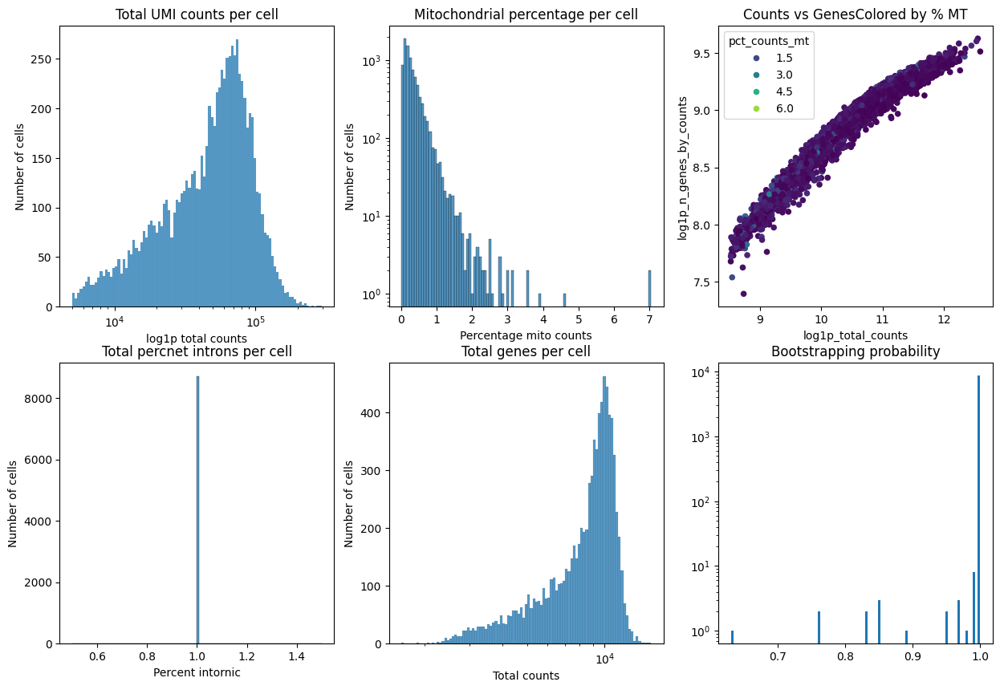

In [83]:
# bring back counts to X
query_D1_matrix.X = query_D1_matrix.layers["counts"]

# clauclte QC
query_D1_matrix.var["mt"] = query_D1_matrix.var.gene_symbol.str.startswith("MT-") # mitochondrial genes, ATTNETION: the names are in "gene_symbol"
sc.pp.calculate_qc_metrics(query_D1_matrix, qc_vars=['mt'], inplace=True)

# plto qc
preprocessing.plot_qc_metrics(query_D1_matrix) # QC metric distribtuion

**ATTENTION**: choose the thr for filtering according to above plots.

In [84]:
print(f"Starting: {query_D1_matrix.n_obs:,} cells\n")

# Calculate all filters (keep = pass filter)
filters = { # lists of boolen (True == to keep)
    
    'min_UMI': query_D1_matrix.obs["total_counts"] >= 6000, #6000, # from plot above
    'min_genes': query_D1_matrix.obs["n_genes_by_counts"] >= 3000, #3000,
    'mt_threshold': query_D1_matrix.obs["pct_counts_mt"] <= 3, #1,
}

n_start = len(query_D1_matrix)
# Show what each filter removes INDEPENDENTLY
print("Individual filters (cells may fail multiple):")
for name, filt in filters.items():
    print(f"  {name:20s}: {(~filt).sum():6,} would be removed alone")

cells_to_keep = pd.DataFrame(filters).all(axis=1)  # AND
query_D1_matrix.obs["is_noise"] = ["True" if not i else np.nan for i in cells_to_keep]

display(
    pd.crosstab(
        query_D1_matrix.obs["is_noise"],
        query_D1_matrix.obs["zone"], 
        dropna=False
    )
)


Starting: 8,711 cells

Individual filters (cells may fail multiple):
  min_UMI             :     58 would be removed alone
  min_genes           :    167 would be removed alone
  mt_threshold        :     10 would be removed alone


zone,2,3,4,5,6
is_noise,,,,,
NaN,4,331,6240,1897,59
True,0,8,139,32,1


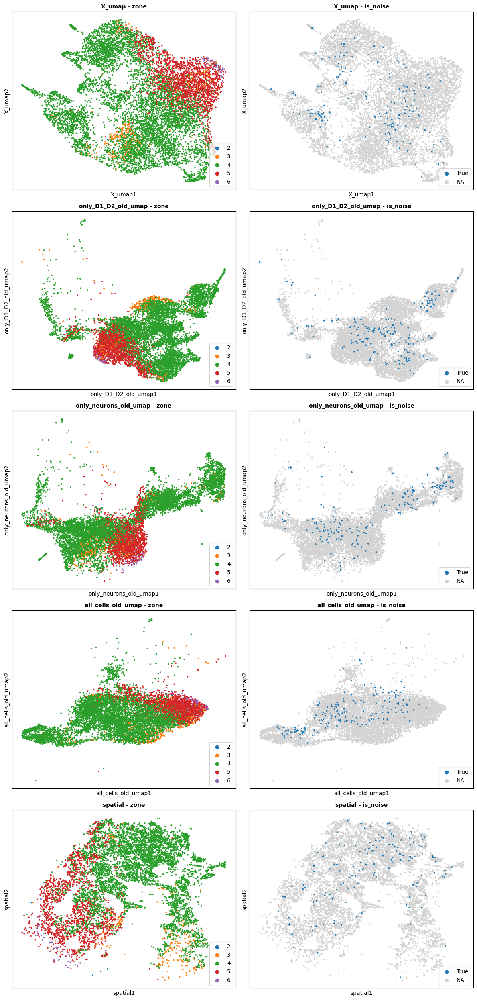

In [85]:
plot_embedding_grid(
    adata=query_D1_matrix,
    bases=['X_umap', 'only_D1_D2_old_umap', 'only_neurons_old_umap', 'all_cells_old_umap', 'spatial'],
    colors=[OBS_COL_ZONE, 'is_noise'],
    highlight_groups={
        "Group_name": [*GROUP_LEVEL_CT_MAKE_D1_MATRIX, *GROUP_LEVEL_CT_MAKE_D2_MATRIX]
    },
    size=30
)

Final: 8,531 / 8,711 cells retained (97.9%)
  Total removed:    180 cells
  Total kept:     8,531 cells


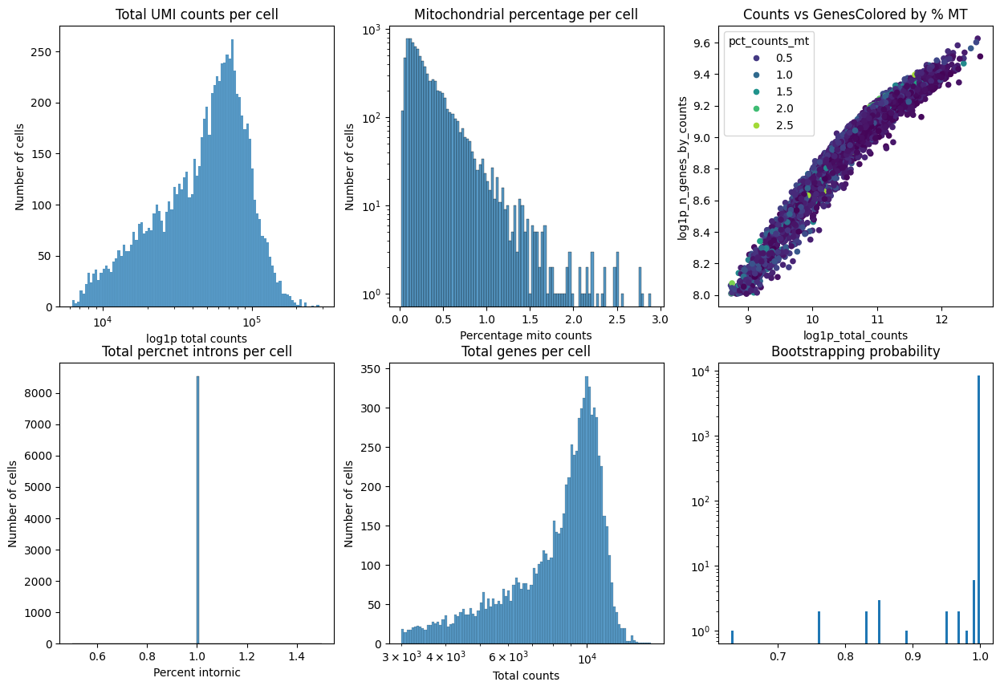

In [86]:
# Filter
query_D1_matrix._inplace_subset_obs(cells_to_keep)

print(f"Final: {query_D1_matrix.n_obs:,} / {n_start:,} cells retained ({100*query_D1_matrix.n_obs/n_start:.1f}%)")
print(f"  Total removed: {(~cells_to_keep).sum():6,} cells")
print(f"  Total kept:    {cells_to_keep.sum():6,} cells")

# replot qc
preprocessing.plot_qc_metrics(query_D1_matrix) # QC metric distribtuion

## Reprocess

In [87]:
# bring back counts to X
query_D1_matrix.X = query_D1_matrix.layers["counts"]
query_D1_matrix.obsm["only_D1_before_QC_old_umap"] = query_D1_matrix.obsm["X_umap"].copy()
query_D1_matrix.obsm["only_D1_before_QC_old_pca"] = query_D1_matrix.obsm["X_pca"].copy()

# Filter genes
print(f"   Genes before filtering: {query_D1_matrix.n_vars}")
sc.pp.filter_genes(query_D1_matrix, min_cells=3)
print(f"   Genes after filtering: {query_D1_matrix.n_vars}")

# reprocess
preprocessing.preprocess(query_D1_matrix, n_pcs_elbow=30, n_hvg=3000, verbose=False)

   Genes before filtering: 32874
   Genes after filtering: 32862
Expect .X is raw counts!
Normalizing...
Findingn HVGs...
Scaling...


/home/gdallagl/.pyenv/versions/3.11.8/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


Calculating PCA...
Calculating neighbors...
Calculating Umap...
Clutering...
Preprocessing done.


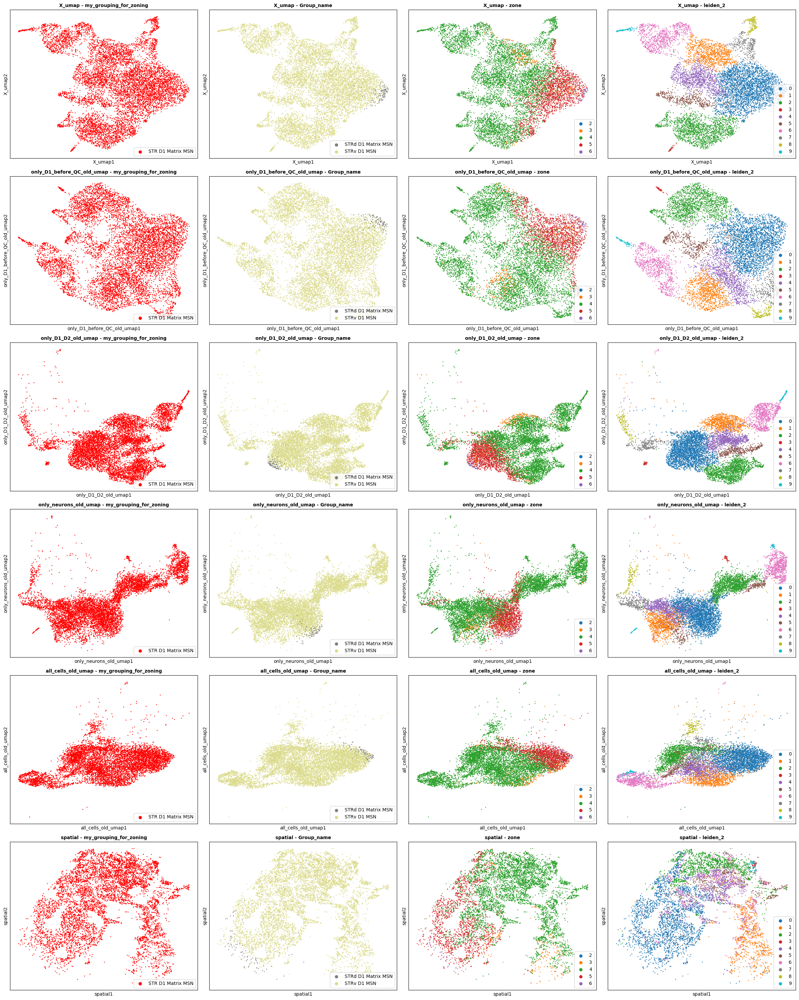

In [88]:
plot_embedding_grid(
    adata=query_D1_matrix,
    bases=['X_umap', 'only_D1_before_QC_old_umap', 'only_D1_D2_old_umap', 'only_neurons_old_umap', 'all_cells_old_umap', 'spatial'],
    colors=[QUERY_CT_ANNOTATION, "Group_name", OBS_COL_ZONE, "leiden_2"],
    highlight_groups={
        "Group_name": [*GROUP_LEVEL_CT_MAKE_D1_MATRIX, *GROUP_LEVEL_CT_MAKE_D2_MATRIX]
    },
    size=15
)

## Visaul inspection for low quality cells

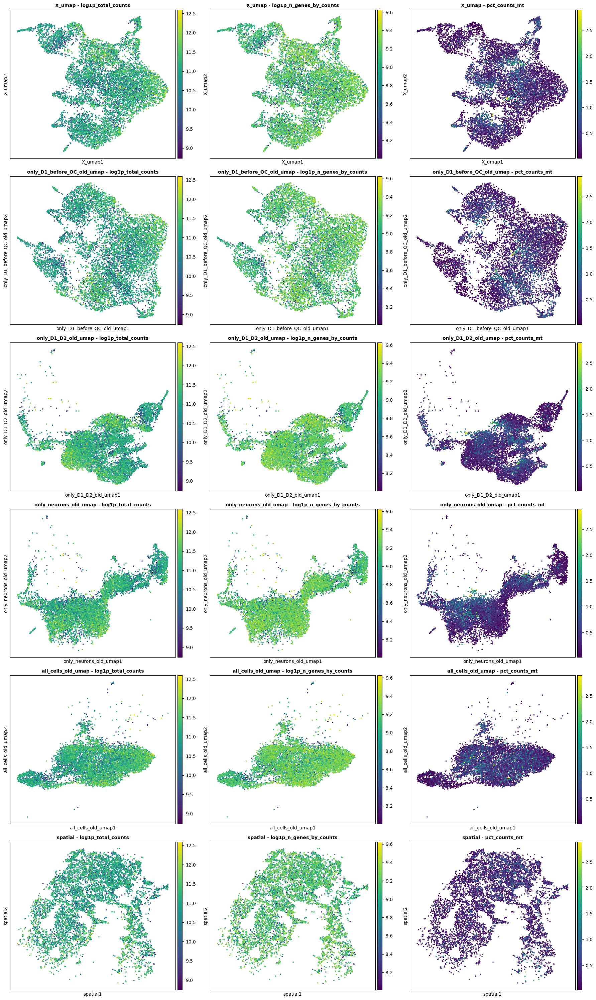

In [89]:
plot_embedding_grid(
    adata=query_D1_matrix,
    bases=['X_umap', 'only_D1_before_QC_old_umap', 'only_D1_D2_old_umap', 'only_neurons_old_umap', 'all_cells_old_umap', 'spatial'],
    colors=["log1p_total_counts", "log1p_n_genes_by_counts", "pct_counts_mt",],
    highlight_groups={
        "Group_name": [*GROUP_LEVEL_CT_MAKE_D1_MATRIX, *GROUP_LEVEL_CT_MAKE_D2_MATRIX]
    },
    size=30
)

## Label TAFA1 cells

MSN D1 Matrix --> Subcelltype

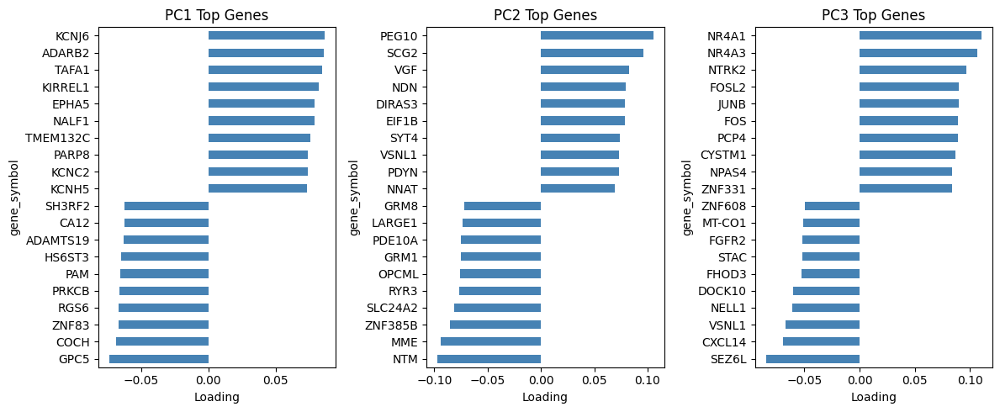

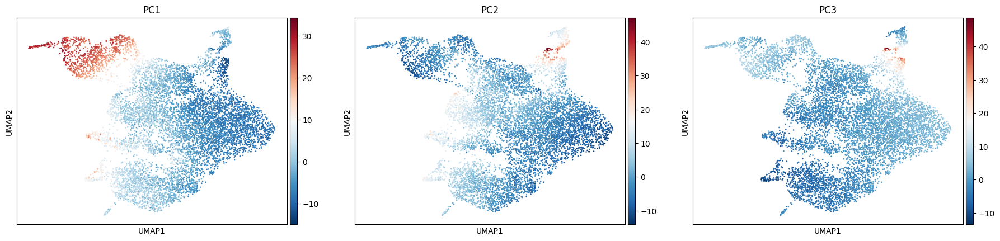

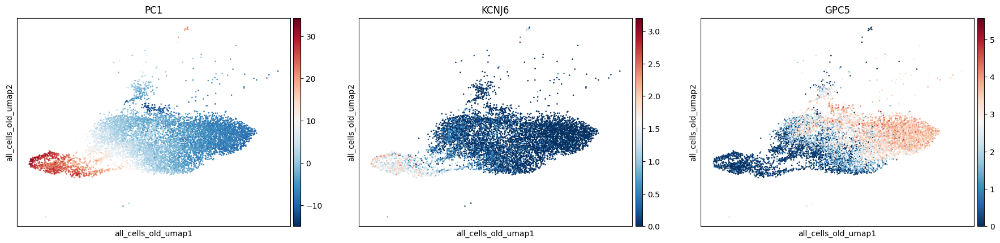

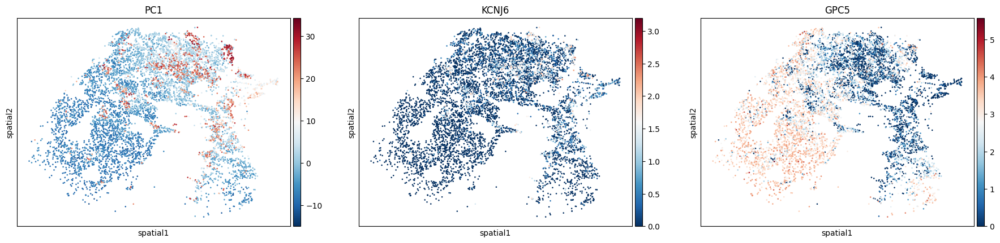

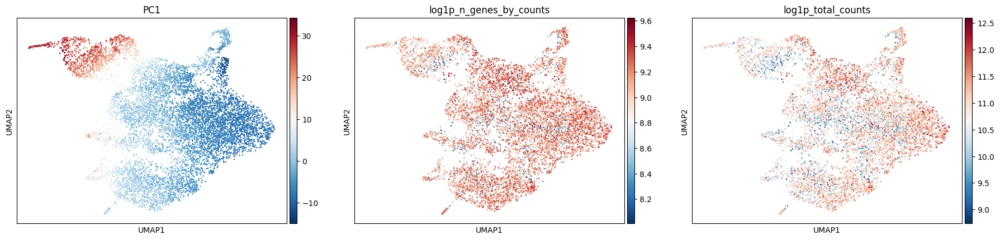

In [94]:
pc1_genes =preprocessing.show_top_pc_genes(query_D1_matrix, n_pcs=3, top_n=10)
sc.pl.embedding(query_D1_matrix, basis='all_cells_old_umap', color=['PC1', *pc1_genes], cmap='RdBu_r', ncols=4, gene_symbols="gene_symbol", layer="log1p_norm")
sc.pl.embedding(query_D1_matrix, basis='spatial', color=['PC1', *pc1_genes], cmap='RdBu_r', ncols=4, gene_symbols="gene_symbol", layer="log1p_norm")
sc.pl.umap(query_D1_matrix, color=['PC1', 'log1p_n_genes_by_counts', 'log1p_total_counts'], cmap='RdBu_r')

# sc.pl.pca_variance_ratio(query_tmp, log=True, n_pcs=80, show=True)


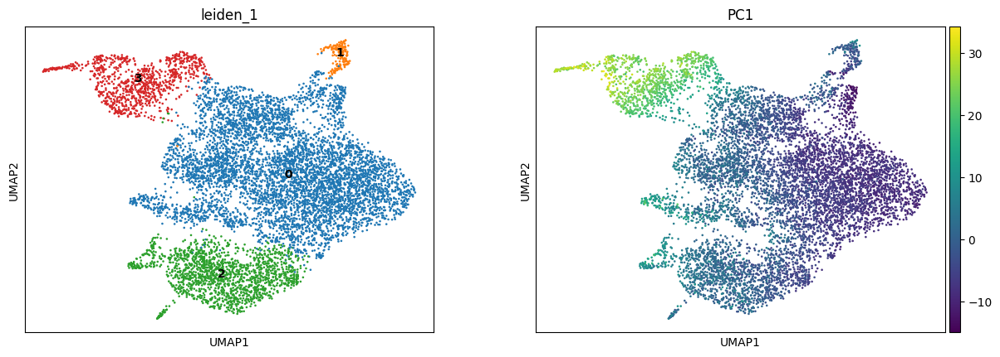

In [95]:
sc.pl.umap(query_D1_matrix, color=["leiden_1", "PC1"], legend_loc="on data")

In [96]:
# Select taf1 cells
LEIDEN_1_TAFA1_CLUSTER = "3"
tafa1_barcodes = query_D1_matrix.obs[query_D1_matrix.obs["leiden_1"].isin([LEIDEN_1_TAFA1_CLUSTER])].index.to_list()
tafa1_barcodes[:2]

query_D1_matrix.obs["is TAFA1"] = np.nan
query_D1_matrix.obs.loc[query_D1_matrix.obs.index.isin(tafa1_barcodes), "is TAFA1"] = "True"


/tmp/ipykernel_454932/2418056053.py:7: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'True' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  query_D1_matrix.obs.loc[query_D1_matrix.obs.index.isin(tafa1_barcodes), "is TAFA1"] = "True"


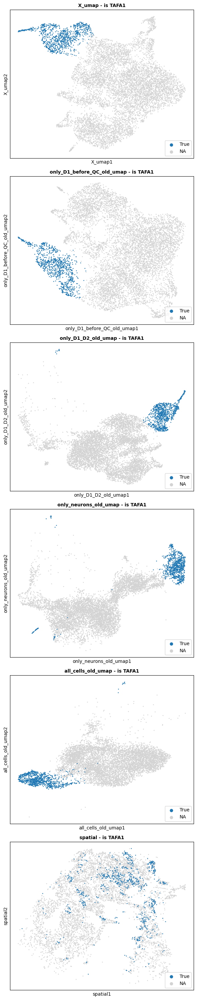

In [97]:
plot_embedding_grid(
    adata=query_D1_matrix,
    bases=['X_umap', 'only_D1_before_QC_old_umap', 'only_D1_D2_old_umap', 'only_neurons_old_umap', 'all_cells_old_umap', 'spatial'],
    colors=["is TAFA1"],
    highlight_groups={
        "Group_name": [*GROUP_LEVEL_CT_MAKE_D1_MATRIX, *GROUP_LEVEL_CT_MAKE_D2_MATRIX]
    },
    size=15
)

## Reprocess remaning cells

In [98]:
query_D1_matrix = query_D1_matrix[~query_D1_matrix.obs.index.isin(tafa1_barcodes)].copy()

print(query_D1_matrix)

# bring back counts to X
query_D1_matrix.X = query_D1_matrix.layers["counts"]
query_D1_matrix.obsm["only_D1_before_TAFA1_old_umap"] = query_D1_matrix.obsm["X_umap"].copy()
query_D1_matrix.obsm["only_D1_before_TAFA1_old_pca"] = query_D1_matrix.obsm["X_pca"].copy()


# Filter genes
print(f"\n  Genes before filtering: {query_D1_matrix.n_vars}")
sc.pp.filter_genes(query_D1_matrix, min_cells=3)
print(f"   Genes after filtering: {query_D1_matrix.n_vars}\n")

preprocessing.preprocess(query_D1_matrix, n_pcs_elbow=30, n_hvg=3000, verbose=False)

AnnData object with n_obs × n_vars = 7570 × 32862
    obs: 'total_counts', 'n_genes', 'logumi', 'pct_counts_mt', 'seurat_clusters', 'x', 'y', 'library', 'cell_class', 'cell_subclass', 'reclustered_patch_matrix_exotic', 'has_spatial', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Neighborhood_aggregate_probability', 'Neighborhood_correlation_coefficient', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Class_aggregate_probability', 'Class_correlation_coefficient', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Subclass_aggregate_probability', 'Subclass_correlation_coefficient', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Group_aggregate_probability', 'Group_correlation_coefficient', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Cluster_aggregate_probability', 'Cluster_correlation_coefficient', 'pct_intronic', 'is_cell', 'n_genes_by_counts', '

/home/gdallagl/.pyenv/versions/3.11.8/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


Calculating PCA...
Calculating neighbors...
Calculating Umap...
Clutering...
Preprocessing done.


After preprocessign wiht aonly subset of cells. the cells cluster very well (no mix, or outlioers), it menas that intial mix in umap was just due to all clel types variance.

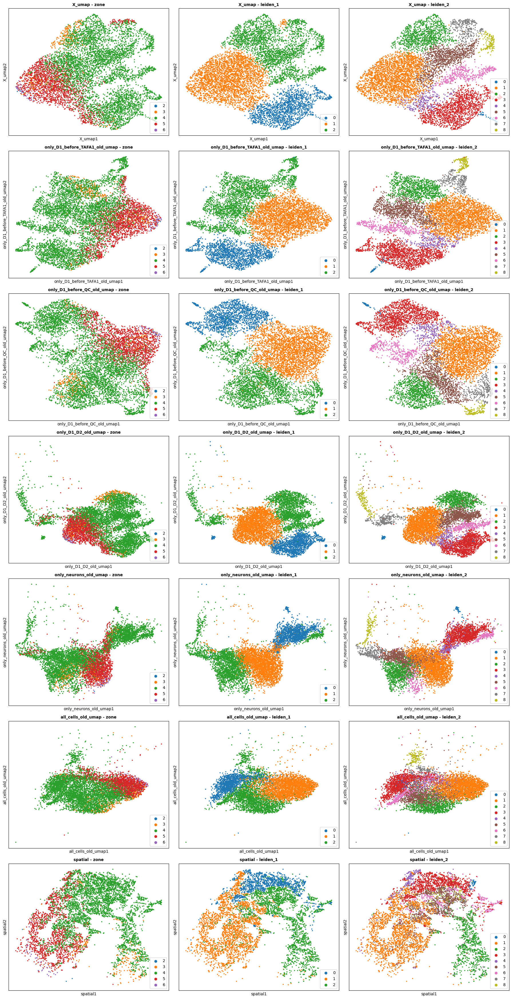

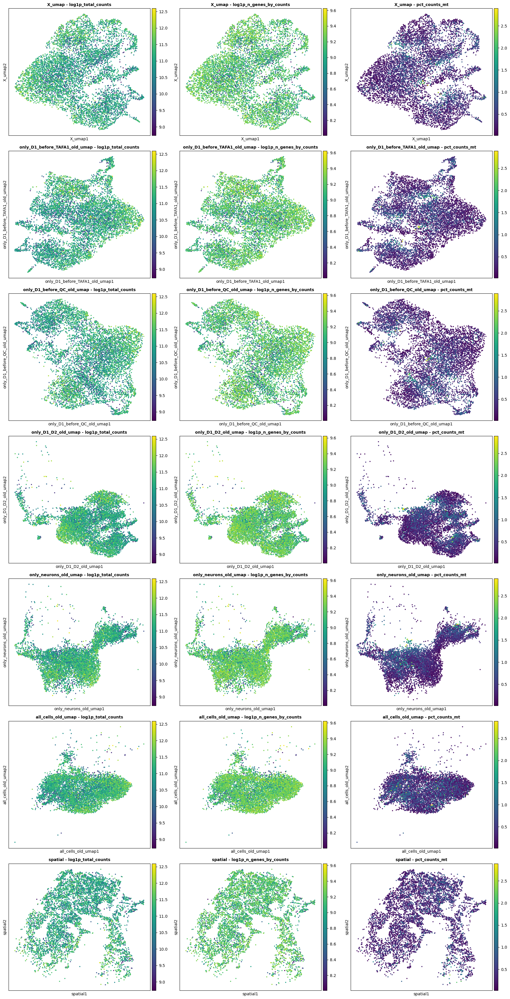

In [99]:
plot_embedding_grid(
    adata=query_D1_matrix,
    bases=['X_umap', 'only_D1_before_TAFA1_old_umap', 'only_D1_before_QC_old_umap', 'only_D1_D2_old_umap', 'only_neurons_old_umap', 'all_cells_old_umap', 'spatial'],
    colors=[OBS_COL_ZONE, "leiden_1", "leiden_2"],
    highlight_groups={
        "Group_name": [*GROUP_LEVEL_CT_MAKE_D1_MATRIX, *GROUP_LEVEL_CT_MAKE_D2_MATRIX]
    },
    size=30
)

plot_embedding_grid(
    adata=query_D1_matrix,
    bases=['X_umap', 'only_D1_before_TAFA1_old_umap','only_D1_before_QC_old_umap', 'only_D1_D2_old_umap', 'only_neurons_old_umap', 'all_cells_old_umap', 'spatial'],
    colors=["log1p_total_counts", "log1p_n_genes_by_counts", "pct_counts_mt",],
    highlight_groups={
        "Group_name": [*GROUP_LEVEL_CT_MAKE_D1_MATRIX, *GROUP_LEVEL_CT_MAKE_D2_MATRIX]
    },
    size=30
)

## Plot Quality Markers

### Markers "Activity"

In [100]:
MSN_activity_markers = { # Only few cells shodul have it, if may cells in dataset have, some prpbel in dissociation
    'General_Neuronal_Activity': [ # Neurons that recently fired action potentials
        'FOS', 'JUNB', 'FOSL2', 'EGR1', 'ARC', 'NPAS4'
    ],
    
    'D1_MSN_Activity': [  # D1-MSNs responding to dopamine signaling
        'NR4A1', 'NR4A3', 'FOS', 'FOSB', 'NPAS4', 'SIK1'
    ],
    
    'MAPK_Feedback': [  # Negative feedback after activity
        'DUSP1', 'DUSP5', 'DUSP6', 'SPRY4'
    ],
}

In [101]:
query_D1_matrix.var.index = query_D1_matrix.var["gene_symbol"]
query_D1_matrix.var.index = query_D1_matrix.var["gene_symbol"].astype(str)
query_D1_matrix.var.index.name = '_index'
query_D1_matrix.var_names_make_unique()

Assure that adata.var.index has same gene name of makers...


  0%|          | 0/3 [00:00<?, ?it/s]

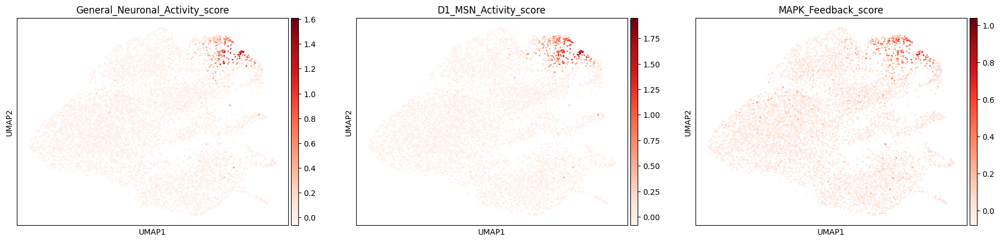

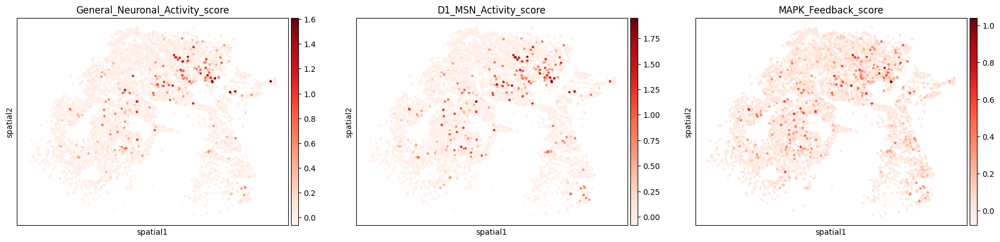

In [102]:
preprocessing.calculate_and_plot_markers(query_D1_matrix, MSN_activity_markers)

### Markers Inflamation

In [103]:
inflammation_markers = {
    
    'Type_I_Interferon_Response': [
        "IFIT1",  # Interferon-induced protein with tetratricopeptide repeats 1
        "IFIT2",  # Interferon-induced protein with tetratricopeptide repeats 2
        "IFIT3",  # Interferon-induced protein with tetratricopeptide repeats 3
        "ISG15",  # Interferon-stimulated gene 15
        "IFI44",  # Interferon-induced protein 44
        "OAS1",   # 2'-5'-oligoadenylate synthetase 1
        "MX1",    # MX dynamin-like GTPase 1
        "MX2",    # MX dynamin-like GTPase 2
        "RSAD2",  # Radical S-adenosyl methionine domain containing 2 (Viperin)
        "IRF7",   # Interferon regulatory factor 7
        "IFITM3", # Interferon induced transmembrane protein 3
    ],
    
    'JAK_STAT_Inflammatory': [
        "STAT1",  # Signal transducer and activator of transcription 1
        "STAT2",  # Signal transducer and activator of transcription 2
        "STAT3",  # Signal transducer and activator of transcription 3
        "JAK1",   # Janus kinase 1
        "JAK2",   # Janus kinase 2
    ],
    
    'Additional_ISGs': [  # Additional interferon-stimulated genes
        "IFI6",   # Interferon alpha-inducible protein 6
        "IFI16",  # Interferon gamma-inducible protein 16
        "IFI27",  # Interferon alpha-inducible protein 27
        "IFI35",  # Interferon-induced protein 35
        "IFIH1",  # Interferon induced with helicase C domain 1 (MDA5)
        "DDX58",  # DExD/H-box helicase 58 (RIG-I)
        "DHX58",  # DExH-box helicase 58 (LGP2)
    ],
    
    'Antiviral_Defense': [
        "ZC3HAV1", # Zinc finger CCCH-type containing, antiviral 1
        "TRIM21",  # Tripartite motif containing 21
        "PARP12",  # Poly(ADP-ribose) polymerase family member 12
        "USP18",   # Ubiquitin specific peptidase 18
        "DDX60",   # DExD/H-box helicase 60
    ],
}

# All interferon genes combined
inflammation_markers['All_Interferon'] = (
    inflammation_markers['Type_I_Interferon_Response'] + 
    inflammation_markers['Additional_ISGs']
)

Assure that adata.var.index has same gene name of makers...


  0%|          | 0/5 [00:00<?, ?it/s]

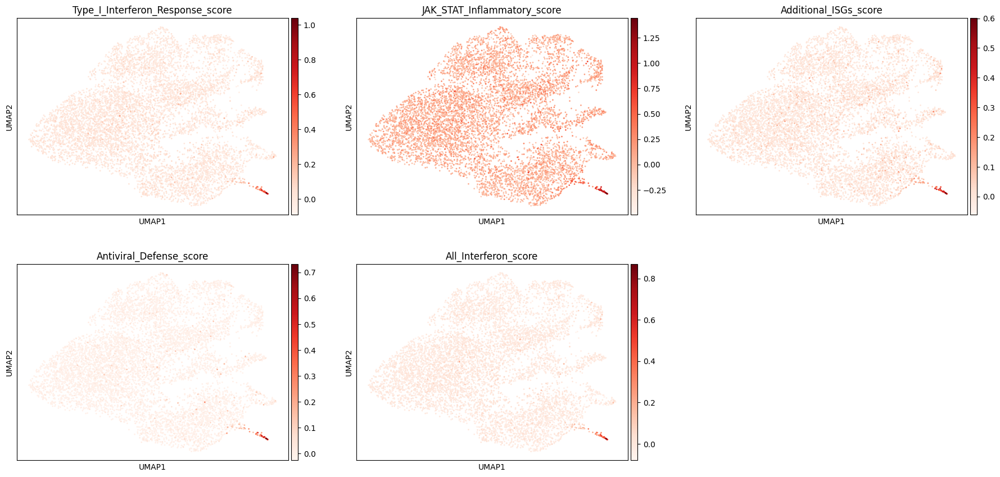

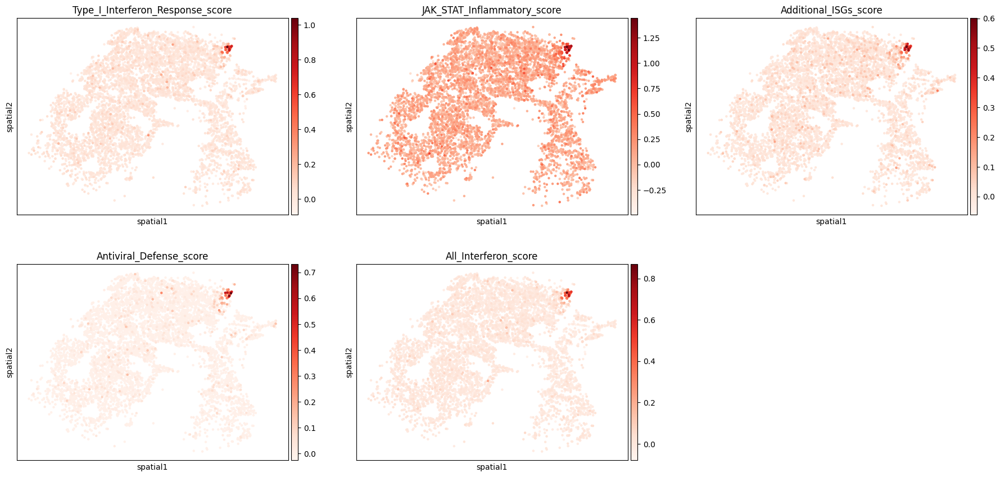

In [104]:
preprocessing.calculate_and_plot_markers(query_D1_matrix, inflammation_markers)

### Markers "Quality Andrew"

Assure that adata.var.index has same gene name of makers...


  0%|          | 0/6 [00:00<?, ?it/s]

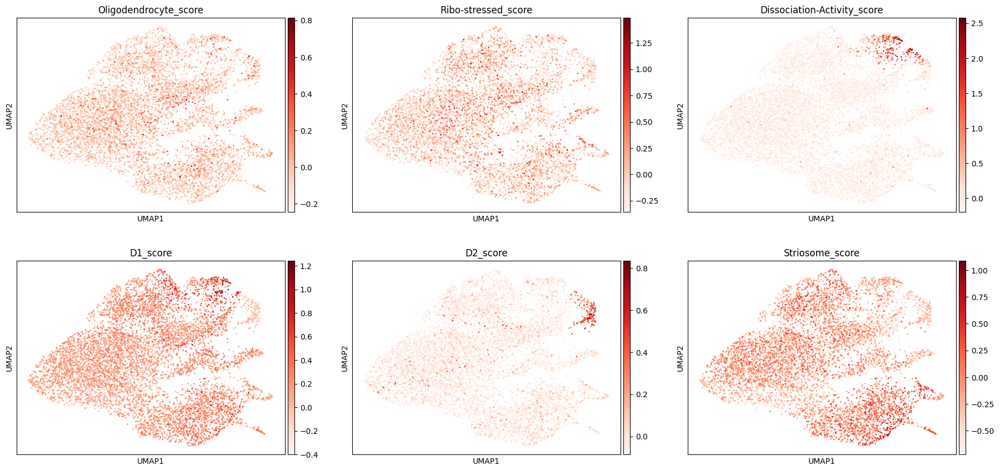

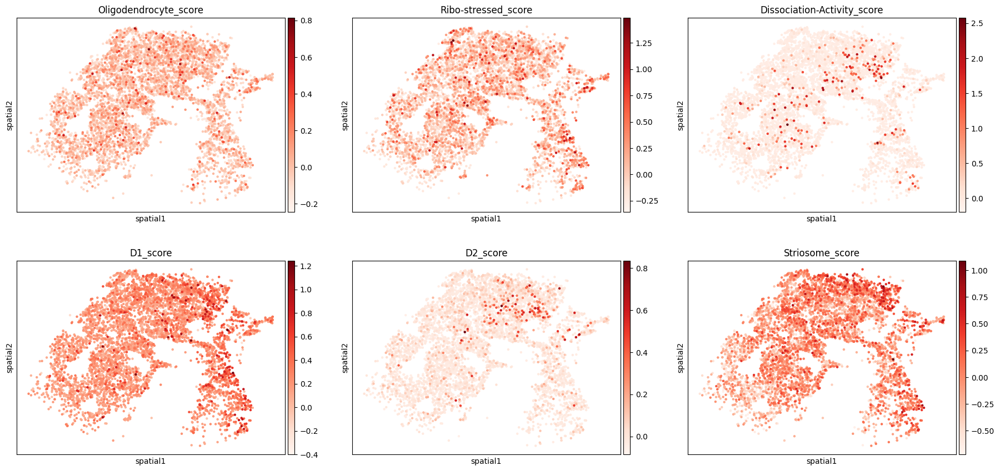

In [112]:

QC_andrew = {
    
    'Oligodendrocyte': ['TF', 'PLP1', 'MOBP', 'TMEM144'],  # Should be ZERO in neurons

    'Ribo-stressed': ['RPL26'], 

    "Dissociation-Activity": ["NR4A1"], # IEG -  induced by neuronal activity --> artificially HIGH due to dissociation stress

    "D1": ['DRD1', 'PDYN', 'TAC1', 'SLC35D3', 'FOXP1'],

    "D2": ['DRD2', 'ADORA2A', 'GPR52'], 

    "Striosome": ['OPRM1', 'MOR1', 'FOXP2', 'UTS2B'],
}

preprocessing.calculate_and_plot_markers(query_D1_matrix, QC_andrew)

## Ivestigate single clusters

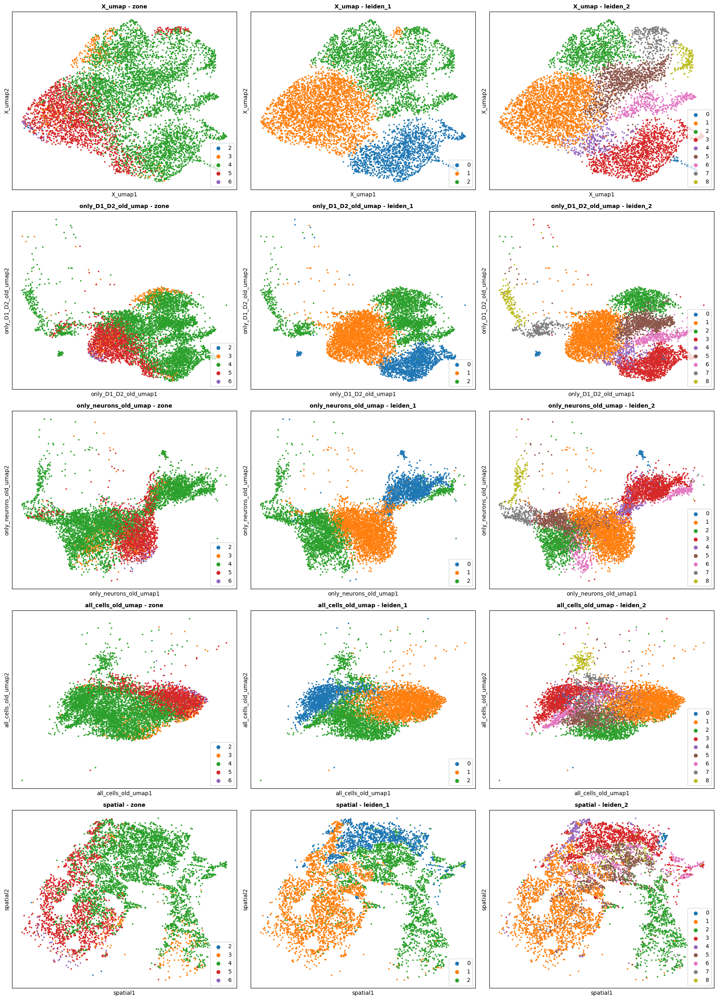

In [107]:
plot_embedding_grid(
    adata=query_D1_matrix,
    bases=['X_umap', 'only_D1_D2_old_umap', 'only_neurons_old_umap', 'all_cells_old_umap', 'spatial'],
    colors=[OBS_COL_ZONE, "leiden_1", "leiden_2"],
    highlight_groups={
        "Group_name": [*GROUP_LEVEL_CT_MAKE_D1_MATRIX, *GROUP_LEVEL_CT_MAKE_D2_MATRIX]
    },
    size=30
)


CLUSTER: 0 --> PROBABLY: inflamation


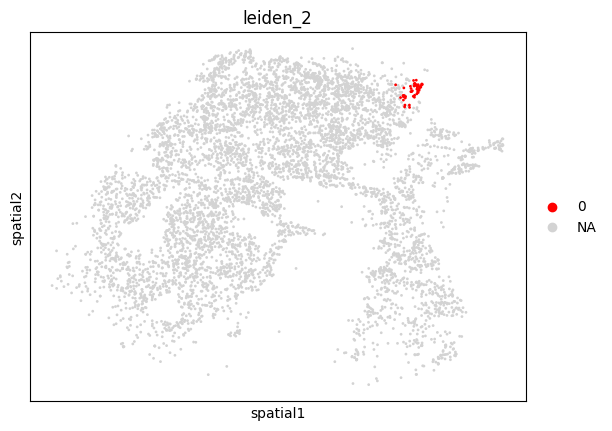


Total DEGs across all clusters: 50


,names,scores,logfoldchanges,pvals,pvals_adj,pct_nz_group,pct_nz_reference,gene_symbol
3,IFI6,12.209658,5.856267,2.760477e-34,2.250065e-30,0.963636,0.104990,IFI6
14,IRF9,10.459587,4.562665,1.324320e-25,2.878542e-22,0.854545,0.108849,IRF9
19,PHF11,9.305763,3.731178,1.330331e-20,2.033977e-17,0.800000,0.183633,PHF11
26,TAP1,8.965701,4.574447,3.083144e-19,3.590101e-16,0.745455,0.097538,TAP1
29,ATP10A,8.842655,3.972524,9.347045e-19,9.830679e-16,0.763636,0.122821,ATP10A
31,HELZ2,8.802620,8.107630,1.336581e-18,1.320542e-15,0.690909,0.005855,HELZ2
39,ZC3HAV1,8.245912,6.971574,1.639055e-16,1.214540e-13,0.654545,0.022888,ZC3HAV1
46,DDX60,7.761594,6.278304,8.386850e-15,5.063794e-12,0.618182,0.015702,DDX60
47,IFIT5,7.748868,3.296376,9.271506e-15,5.445585e-12,0.690909,0.156088,IFIT5
57,USP18,7.172963,5.279982,7.339168e-13,3.370229e-10,0.581818,0.037392,USP18


['IFI6', 'IRF9', 'PHF11', 'TAP1', 'ATP10A', 'HELZ2', 'ZC3HAV1', 'DDX60', 'IFIT5', 'USP18', 'ENSG00000285744', 'DHX58', 'IFIT3', 'APOL2', 'TRHR', 'IFI16', 'TNS1', 'PSMB9', 'PARP12', 'IFI44', 'OAS1', 'TRIM21', 'CASP7', 'IRF1', 'CD274', 'RGMA', 'ENSG00000236985', 'PSME1', 'ISG15', 'PATL2', 'SERPING1', 'COL4A2', 'HERC5', 'DPY19L1', 'WDR64', 'PARP14', 'IGSF21', 'LINC01208', 'HLA-E', 'SYTL3', 'GBP3', 'IFIT2', 'SMTNL1', 'RBM43', 'MYD88', 'PARP10', 'ILDR2', 'GRM3-AS1', 'PSMB8', 'CD68']
Running enrichment on 50 genes...

=== Top Enriched Pathways ===


,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,MSigDB_Hallmark_2020,Interferon Alpha Response,18/97,6.602888e-30,1.254549e-28,0,0,141.486551,9506.487808,TAP1;IFI44;ISG15;PARP14;DDX60;USP18;PARP12;IFI...
1,MSigDB_Hallmark_2020,Interferon Gamma Response,21/200,1.783139e-29,1.693982e-28,0,0,79.982855,5294.592465,CD274;TAP1;IFI44;ISG15;PARP14;DDX60;USP18;PARP...
2,MSigDB_Hallmark_2020,Complement,5/200,1.398365e-04,8.856313e-04,0,0,11.256410,99.901053,CASP7;COL4A2;IRF1;SERPING1;PSMB9
3,MSigDB_Hallmark_2020,IL-6/JAK/STAT3 Signaling,3/87,1.344334e-03,6.385586e-03,0,0,15.095745,99.810899,IRF1;IRF9;MYD88
4,MSigDB_Hallmark_2020,Apoptosis,3/161,7.608098e-03,2.891077e-02,0,0,7.995691,39.007314,CASP7;IRF1;TAP1
5,MSigDB_Hallmark_2020,TNF-alpha Signaling via NF-kB,3/200,1.367863e-02,4.331565e-02,0,0,6.400151,27.468942,IRF1;TAP1;IFIT2
19,GO_Biological_Process_2023,Interferon Alpha Response,18/97,6.602888e-30,1.254549e-28,0,0,141.486551,9506.487808,TAP1;IFI44;ISG15;PARP14;DDX60;USP18;PARP12;IFI...
20,GO_Biological_Process_2023,Interferon Gamma Response,21/200,1.783139e-29,1.693982e-28,0,0,79.982855,5294.592465,CD274;TAP1;IFI44;ISG15;PARP14;DDX60;USP18;PARP...
21,GO_Biological_Process_2023,Complement,5/200,1.398365e-04,8.856313e-04,0,0,11.256410,99.901053,CASP7;COL4A2;IRF1;SERPING1;PSMB9
22,GO_Biological_Process_2023,IL-6/JAK/STAT3 Signaling,3/87,1.344334e-03,6.385586e-03,0,0,15.095745,99.810899,IRF1;IRF9;MYD88



CLUSTER: 8 --> PROBABLY: D2


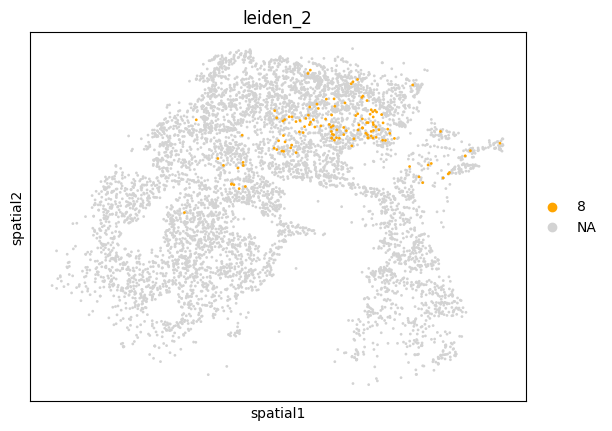


Total DEGs across all clusters: 140


,names,scores,logfoldchanges,pvals,pvals_adj,pct_nz_group,pct_nz_reference,gene_symbol
1,TTC12,18.203236,6.530416,4.864710e-74,1.762322e-70,0.864516,0.041403,TTC12
3,DRD2,18.049753,4.638760,7.924290e-73,2.153030e-69,0.883871,0.182468,DRD2
13,COL21A1,16.031553,3.803169,7.693426e-58,6.270912e-55,0.832258,0.143898,COL21A1
19,CD24,15.102435,4.721656,1.560609e-51,8.624082e-49,0.748387,0.072960,CD24
54,ENSG00000228863,12.599298,4.453105,2.130317e-36,5.033106e-34,0.651613,0.108024,ENSG00000228863
59,ANKK1,12.440190,7.625988,1.581276e-35,3.531227e-33,0.587097,0.006204,ANKK1
75,ADORA2A,11.813617,4.495022,3.319690e-32,6.013066e-30,0.587097,0.049359,ADORA2A
95,SHC4,11.259161,3.265114,2.087375e-29,3.024745e-27,0.632258,0.138908,SHC4
103,SPRY4-AS1,11.036327,4.058447,2.552544e-28,3.467630e-26,0.574194,0.079299,SPRY4-AS1
123,LINC02073,10.522943,3.779778,6.772399e-26,7.971383e-24,0.561290,0.098179,LINC02073


['TTC12', 'DRD2', 'COL21A1', 'CD24', 'ENSG00000228863', 'ANKK1', 'ADORA2A', 'SHC4', 'SPRY4-AS1', 'LINC02073', 'GPR52', 'MOXD1', 'PTGFR', 'CHODL', 'RANBP17', 'ENSG00000253452', 'HGF', 'C1QL3', 'GHSR', 'SLC30A8', 'JUN', 'GEM', 'UPB1', 'LINC02154', 'HAP1', 'TRHR', 'SPRY2', 'ENSG00000286473', 'GADD45B', 'NR4A1', 'SMCO4', 'GLP2R', 'OTOGL', 'RND3', 'CD48', 'BRS3', 'PENK-AS1', 'TOX', 'HTR2A', 'ENSG00000287037', 'GPAT3', 'LINC01619', 'SOX2', 'SEPSECS-AS1', 'AHNAK2', 'GPR150', 'FOSL2', 'ENSG00000228560', 'ENSG00000286691', 'NAT16', 'GNG12', 'ENSG00000233850', 'CENPVL3', 'ENSG00000285681', 'TBKBP1', 'NUDT10', 'LBH', 'CCN3', 'ENSG00000281333', 'PLOD2', 'DUSP4', 'PTTG1', 'ENSG00000286678', 'C2orf50', 'ENSG00000267686', 'ENSG00000287018', 'ZNF208', 'NOTCH2NLA', 'ZNF728', 'ENSG00000282142', 'LAMA2', 'GNAS-AS1', 'INHBA', 'SEMA3C', 'NR4A3', 'MPP4', 'SMIM29', 'C11orf96', 'DUSP6', 'FOSB', 'ZBTB16', 'ILDR2', 'DUSP1', 'WTIP', 'BEX5', 'PTER', 'CITED4', 'SORBS3', 'LCAL1', 'CITED2', 'SEC24D', 'IGSF21', 'AARD

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,MSigDB_Hallmark_2020,TNF-alpha Signaling via NF-kB,12/200,1.711404e-08,5.305354e-07,0,0,9.809840,175.432970,DUSP4;EGR1;NR4A1;JUN;CDKN1A;NR4A3;GADD45B;DUSP...
1,MSigDB_Hallmark_2020,Hypoxia,6/200,2.873553e-03,2.969338e-02,0,0,4.539006,26.563199,JUN;CDKN1A;DUSP1;CITED2;FOSL2;BRS3
2,MSigDB_Hallmark_2020,Epithelial Mesenchymal Transition,6/200,2.873553e-03,2.969338e-02,0,0,4.539006,26.563199,JUN;GADD45B;LAMA2;PLOD2;INHBA;GEM
31,GO_Biological_Process_2023,TNF-alpha Signaling via NF-kB,12/200,1.711404e-08,5.305354e-07,0,0,9.809840,175.432970,DUSP4;EGR1;NR4A1;JUN;CDKN1A;NR4A3;GADD45B;DUSP...
32,GO_Biological_Process_2023,Hypoxia,6/200,2.873553e-03,2.969338e-02,0,0,4.539006,26.563199,JUN;CDKN1A;DUSP1;CITED2;FOSL2;BRS3
33,GO_Biological_Process_2023,Epithelial Mesenchymal Transition,6/200,2.873553e-03,2.969338e-02,0,0,4.539006,26.563199,JUN;GADD45B;LAMA2;PLOD2;INHBA;GEM
62,GO_Cellular_Component_2023,TNF-alpha Signaling via NF-kB,12/200,1.711404e-08,5.305354e-07,0,0,9.809840,175.432970,DUSP4;EGR1;NR4A1;JUN;CDKN1A;NR4A3;GADD45B;DUSP...
63,GO_Cellular_Component_2023,Hypoxia,6/200,2.873553e-03,2.969338e-02,0,0,4.539006,26.563199,JUN;CDKN1A;DUSP1;CITED2;FOSL2;BRS3
64,GO_Cellular_Component_2023,Epithelial Mesenchymal Transition,6/200,2.873553e-03,2.969338e-02,0,0,4.539006,26.563199,JUN;GADD45B;LAMA2;PLOD2;INHBA;GEM
93,KEGG_2021_Human,TNF-alpha Signaling via NF-kB,12/200,1.711404e-08,5.305354e-07,0,0,9.809840,175.432970,DUSP4;EGR1;NR4A1;JUN;CDKN1A;NR4A3;GADD45B;DUSP...



CLUSTER: 7 --> PROBABLY: active MSN


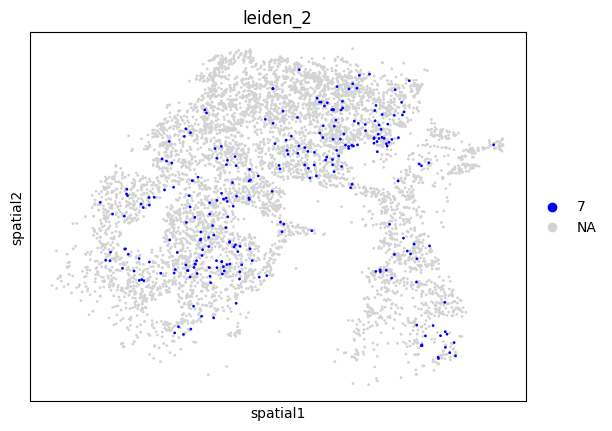


Total DEGs across all clusters: 89


,names,scores,logfoldchanges,pvals,pvals_adj,pct_nz_group,pct_nz_reference,gene_symbol
6,NR4A3,25.291498,7.145187,3.961966e-141,1.845371e-137,0.877076,0.072500,NR4A3
10,NR4A1,24.167301,5.928355,4.912331e-129,1.456015e-125,0.850498,0.089696,NR4A1
11,DUSP1,23.869837,5.396878,6.302797e-126,1.712470e-122,0.840532,0.076076,DUSP1
21,FOSL2,21.657053,4.939491,5.215526e-104,7.729410e-101,0.784053,0.106480,FOSL2
23,SIK1,21.375267,5.411594,2.270221e-101,3.084095e-98,0.750831,0.045261,SIK1
39,FOS,19.704172,6.165040,1.985639e-86,1.596324e-83,0.691030,0.041271,FOS
59,DUSP6,17.506931,3.674508,1.268525e-68,6.780161e-66,0.681063,0.147200,DUSP6
69,SHC4,16.735912,3.750519,7.175015e-63,3.204578e-60,0.654485,0.128078,SHC4
77,NPAS4,16.344595,6.826041,4.753163e-60,1.867134e-57,0.564784,0.013344,NPAS4
129,DPH1-AS1,13.902899,4.883320,6.082701e-44,1.296212e-41,0.495017,0.029303,DPH1-AS1


['NR4A3', 'NR4A1', 'DUSP1', 'FOSL2', 'SIK1', 'FOS', 'DUSP6', 'SHC4', 'NPAS4', 'DPH1-AS1', 'INHBA', 'BTG3-AS1', 'NFIL3', 'ENSG00000287553', 'SST', 'TEX30', 'ENSG00000250069', 'LBH', 'RND3', 'FOSB', 'ENPEP', 'C17orf107', 'ENSG00000228863', 'CITED2', 'ARL4D', 'SFR1', 'OTOGL', 'GADD45B', 'ENSG00000270103', 'OLR1', 'TSPAN9', 'LINC00309', 'ENSG00000272512', 'ENSG00000289354', 'JUN', 'ENSG00000289331', 'SLC25A19', 'SPRY2', 'ENSG00000286334', 'SPRY4-AS1', 'EGR4', 'PDYN-AS1', 'ENSG00000289745', 'CD24', 'ENSG00000289130', 'EGR1', 'KPNA2', 'LAGE3', 'C4orf54', 'PARD6A', 'ENSG00000258663', 'ENSG00000251556', 'LURAP1L-AS1', 'BCAS1', 'HS3ST2', 'ENSG00000289085', 'UBE2S', 'ENSG00000290808', 'IL13RA2', 'CLDN15', 'THBS3-AS1', 'H4C5', 'PVT1', 'GMNN', 'ISG15', 'ENSG00000273702', 'DNM1P35', 'PIGA', 'NAMA', 'ENSG00000266900', 'ENSG00000283217', 'ENSG00000227227', 'CDK2AP2', 'SHISA2', 'TIPARP', 'ENSG00000187186', 'ENSG00000254990', 'PCSK1', 'HSPA1A', 'ENSG00000260805', 'MIR22HG', 'PIM3', 'DNAJB5', 'HSPA1B', 

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,GO_Biological_Process_2023,TNF-alpha Signaling via NF-kB,14/200,2.500555e-13,8.001776e-12,0,0,19.795699,574.413648,EGR1;JUN;GADD45B;TIPARP;DUSP1;FOS;INHBA;FOSL2;...
1,GO_Biological_Process_2023,Hypoxia,7/200,3.102233e-05,4.963574e-04,0,0,8.721471,90.535874,JUN;NFIL3;TIPARP;DUSP1;CITED2;FOS;FOSL2
2,GO_Biological_Process_2023,UV Response Dn,4/144,3.920203e-03,4.181549e-02,0,0,6.645714,36.827970,RGS4;DUSP1;CITED2;RND3
32,MSigDB_Hallmark_2020,TNF-alpha Signaling via NF-kB,14/200,2.500555e-13,8.001776e-12,0,0,19.795699,574.413648,EGR1;JUN;GADD45B;TIPARP;DUSP1;FOS;INHBA;FOSL2;...
33,MSigDB_Hallmark_2020,Hypoxia,7/200,3.102233e-05,4.963574e-04,0,0,8.721471,90.535874,JUN;NFIL3;TIPARP;DUSP1;CITED2;FOS;FOSL2
34,MSigDB_Hallmark_2020,UV Response Dn,4/144,3.920203e-03,4.181549e-02,0,0,6.645714,36.827970,RGS4;DUSP1;CITED2;RND3
64,KEGG_2021_Human,TNF-alpha Signaling via NF-kB,14/200,2.500555e-13,8.001776e-12,0,0,19.795699,574.413648,EGR1;JUN;GADD45B;TIPARP;DUSP1;FOS;INHBA;FOSL2;...
65,KEGG_2021_Human,Hypoxia,7/200,3.102233e-05,4.963574e-04,0,0,8.721471,90.535874,JUN;NFIL3;TIPARP;DUSP1;CITED2;FOS;FOSL2
66,KEGG_2021_Human,UV Response Dn,4/144,3.920203e-03,4.181549e-02,0,0,6.645714,36.827970,RGS4;DUSP1;CITED2;RND3
96,GO_Cellular_Component_2023,TNF-alpha Signaling via NF-kB,14/200,2.500555e-13,8.001776e-12,0,0,19.795699,574.413648,EGR1;JUN;GADD45B;TIPARP;DUSP1;FOS;INHBA;FOSL2;...


In [113]:
LEIDEN = "leiden_2"

cluster_to_investigate = {
    "inflamation": "0", 
    "D2": "8",
    "active MSN": "7",
    # "?": "6",
    # "near vascular": "4"
}

for name, cluster in cluster_to_investigate.items():

    print(f"\nCLUSTER: {cluster} --> PROBABLY: {name}")
    sc.pl.embedding(query_D1_matrix, basis="spatial", color=LEIDEN, groups=[cluster], palette=["red", "blue", "orange", "green", "violet", "pink"])
    deg_filtered, deg_genes, enriched_paths_df = preprocessing.simple_wilcoxon_on_leiden(
        query_D1_matrix, leiden_col=LEIDEN, leiden_cluster=cluster, n_genes_gsea=None)

### DEG 2 clusters

In [ ]:
preprocessing.wilcoxon_between_two_clusters(
    query_D1_matrix, 
    leiden_col="leiden_1", 
    cluster_A="1", 
    cluster_B="3",
    n_genes_gsea=None,

)

## Final Filter bad MSN

In [ ]:

# NOT YET FOUND NECESSARY
    # maybe delete entire leiden cluster tdue to low qwuality
    # remoc cells wiht low QC genes (RPL25, MBP, NR4A1)

#query_D1_matrix

# Filter MSN

In [114]:
tafa1_barcodes

msn_ok_barcodes = set(query_D1_matrix.obs_names)

all_msn_barcodes = set(query[query.obs[QUERY_CT_ANNOTATION].notna()].obs_names) #how the intial adata_tmp was created

# cell of this cell type (query[query.obs[QUERY_CT_ANNOTATION] == CELL_TYPE_QUERY_CT_ANNOTATION]) 
    # MINUS hte one remained after the filtering
    # MINUS TAFA1 cells
cell_to_remove = all_msn_barcodes.difference(msn_ok_barcodes).difference(tafa1_barcodes)


# Filter query
query = query[~query.obs_names.isin(cell_to_remove)]


# add tafa1 names
query.obs["Group_name"] = query.obs["Group_name"].astype(str).replace("nan", np.nan)
query.obs.loc[query.obs.index.isin(tafa1_barcodes), "Group_name"] = "Tafa1 STR D1 Matrix MSN" # save for futre in mmc col

query.obs[QUERY_CT_ANNOTATION] = query.obs[QUERY_CT_ANNOTATION].astype(str).replace("nan", np.nan)
query.obs.loc[query.obs.index.isin(tafa1_barcodes), QUERY_CT_ANNOTATION] = "Tafa1 STR D1 Matrix MSN" # no more norma MNS D1

query

/tmp/ipykernel_454932/3886340794.py:18: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  query.obs["Group_name"] = query.obs["Group_name"].astype(str).replace("nan", np.nan)


AnnData object with n_obs × n_vars = 126266 × 36190
    obs: 'total_counts', 'n_genes', 'logumi', 'pct_counts_mt', 'seurat_clusters', 'x', 'y', 'library', 'cell_class', 'cell_subclass', 'reclustered_patch_matrix_exotic', 'has_spatial', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Neighborhood_aggregate_probability', 'Neighborhood_correlation_coefficient', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Class_aggregate_probability', 'Class_correlation_coefficient', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Subclass_aggregate_probability', 'Subclass_correlation_coefficient', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Group_aggregate_probability', 'Group_correlation_coefficient', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Cluster_aggregate_probability', 'Cluster_correlation_coefficient', 'pct_intronic', 'is_cell', 'n_genes_by_counts',

# Save

In [115]:
query.write(f'{BASE_PATH}/{DISEASE_TYPE}/{SAMPLE_ID}/adata/all_lib_adata_zoned.h5ad')
query_D1_matrix.write(f'{BASE_PATH}/{DISEASE_TYPE}/{SAMPLE_ID}/adata/only_D1_matrix_curated.h5ad')


In [ ]:
#query = sc.read_h5ad(f'{BASE_PATH}/{DISEASE_TYPE}/{SAMPLE_ID}/adata/all_lib_adata_zoned.h5ad')
#query_D1_matrix = sc.read_h5ad(f'{BASE_PATH}/{DISEASE_TYPE}/{SAMPLE_ID}/adata/only_D1_matrix_curated.h5ad')

# Plot

In [116]:
size=20

palette_str = os.getenv("PALETTE")
palette = {int(k): v for k, v in json.loads(palette_str).items()}
palette

{1: '#9467bd',
 2: '#8c564b',
 3: '#2ca02c',
 4: '#d62728',
 5: '#1f77b4',
 6: '#ff7f0e'}

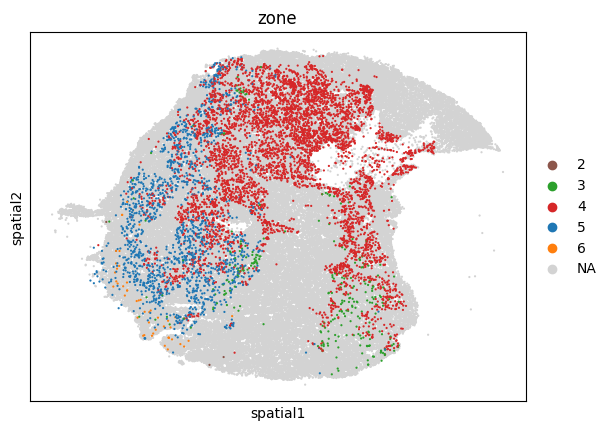

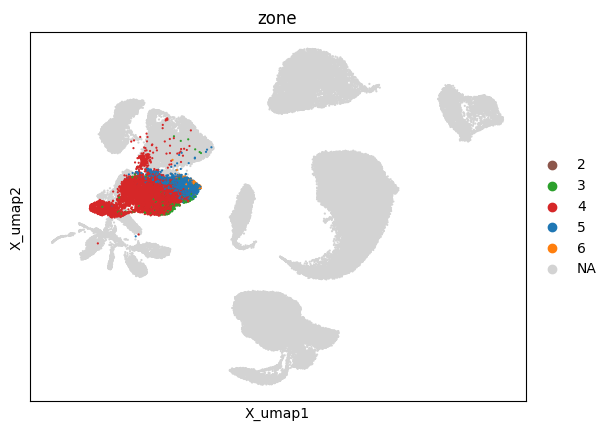

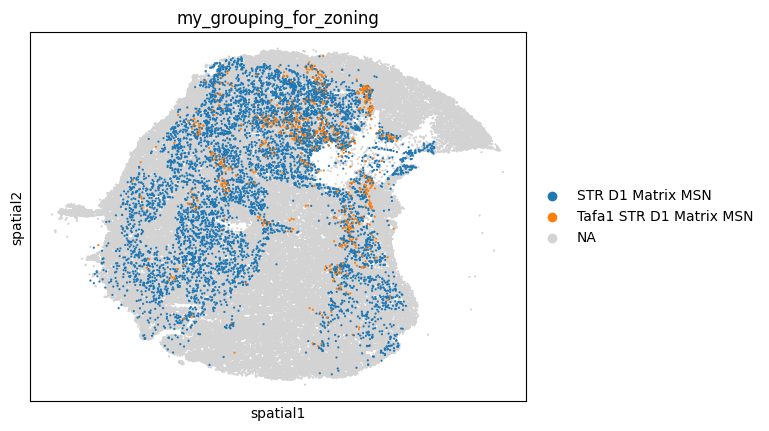

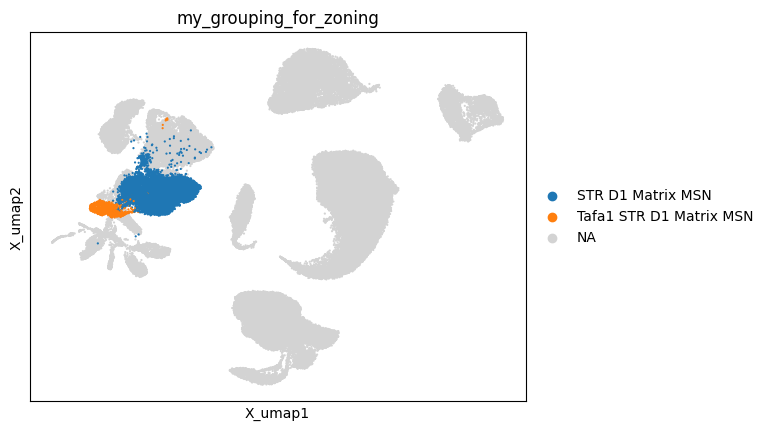

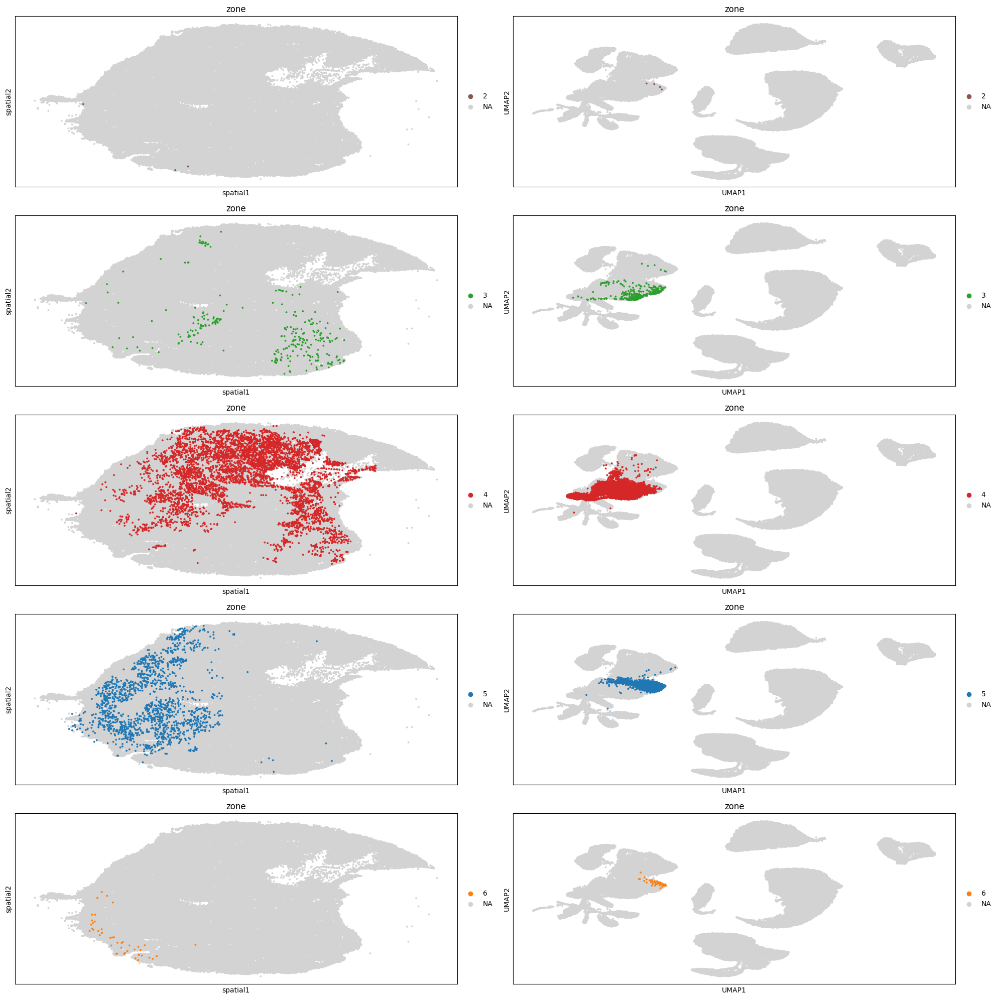

In [117]:
sc.pl.embedding(query, basis="spatial", color="zone", size=10, palette=palette)
sc.pl.embedding(query, basis="X_umap", color="zone", size=10, palette=palette)

sc.pl.embedding(query, basis="spatial", color=QUERY_CT_ANNOTATION, size=10)
sc.pl.embedding(query, basis="X_umap", color=QUERY_CT_ANNOTATION, size=10)

# Get zones (remove NaN)
zones = query.obs["zone"].dropna().sort_values().unique().tolist()

# Plot each zone
fig, axes = plt.subplots(len(zones), 2, figsize=(20, 4 * len(zones)))
size=30

for i, zone in enumerate(zones):

    # Plot
    sc.pl.embedding(query, basis="spatial", color="zone", size=size, 
                    palette=palette, groups=[zone], ax=axes[i, 0], show=False)
    sc.pl.umap(query, color="zone", size=size, palette=palette, 
                groups=[zone], ax=axes[i, 1], show=False)


plt.tight_layout()
plt.show()

### Gene Markers zones

{1: ['WLS', 'KEL', 'STRIT1', 'LINC00958'], 2: ['ENSG00000259255', 'ENSG00000258426'], 3: ['HTR2A', 'AMIGO2', 'ENSG00000258181'], 4: ['ENSG00000287925', 'TIMP2', 'COL21A1', 'BAIAP3'], 5: ['SLC5A8', 'ENSG00000287922'], 6: ['RXFP2', 'LINC02045']}


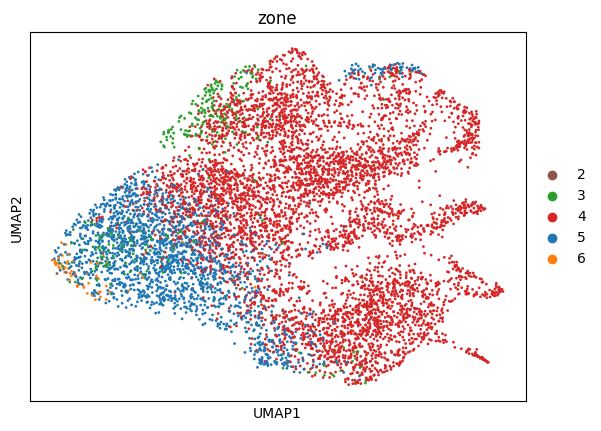

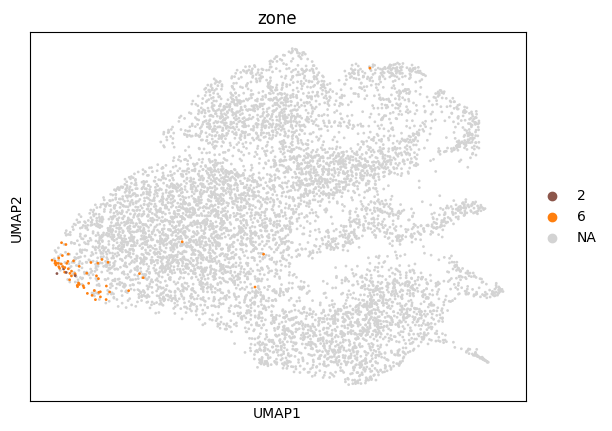

Assure that adata.var.index has same gene name of makers...


  0%|          | 0/6 [00:00<?, ?it/s]

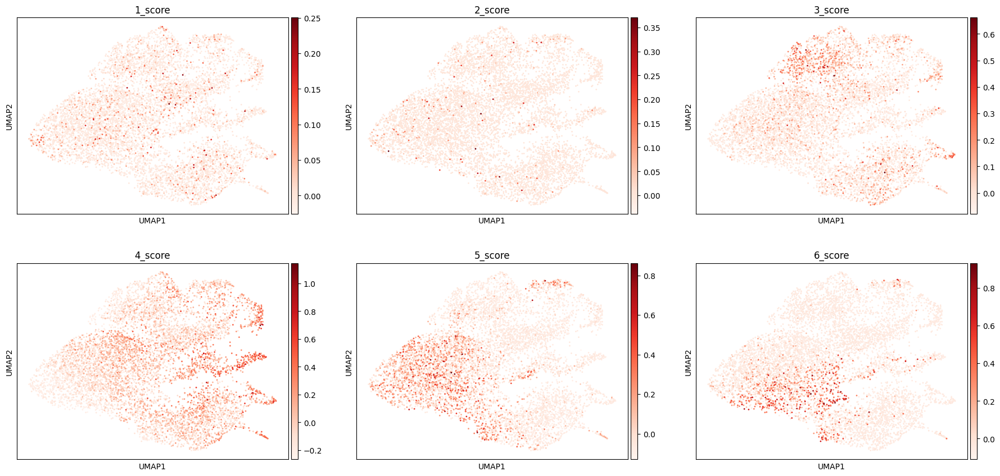

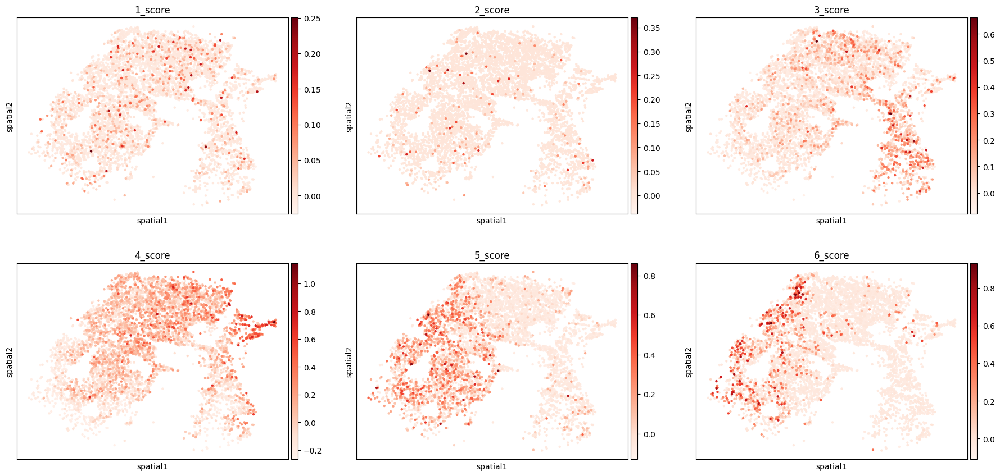

In [118]:

zone_marker_genes_str = os.getenv("ZONE_MARKERS")
zone_marker_genes = {int(k): v for k, v in json.loads(zone_marker_genes_str).items()}
print(zone_marker_genes)

sc.pl.umap(query_D1_matrix, color="zone", palette=palette)
sc.pl.umap(query_D1_matrix, color="zone", palette=palette, groups=[1,2,6])


preprocessing.calculate_and_plot_markers(query_D1_matrix, zone_marker_genes)

# Save Notebook

In [2]:
# Get the notebook path
notebook_path = str(ipynbname.path())
print(f"Current notebook: {notebook_path}")

# Save it
base_name = os.path.basename(notebook_path).replace('.ipynb', '')  # Remove .ipynb
saving_path = f"{BASE_PATH}/{DISEASE_TYPE}/{SAMPLE_ID}/notebooks/{base_name}_{SAMPLE_ID}.ipynb"
print(f"Saved to {saving_path}")

print("\n   Press Ctrl+S")

Current notebook: /home/gdallagl/myworkdir/XDP/script/single_sample_analysis/05_zone_labelling_D1_matrix.ipynb
Saved to /home/gdallagl/myworkdir/data/XDP/diseased/recon_241105/notebooks/05_zone_labelling_D1_matrix_recon_241105.ipynb

   Press Ctrl+S


In [7]:
shutil.copy(notebook_path, saving_path)

'/home/gdallagl/myworkdir/data/XDP/diseased/recon_241105/notebooks/05_zone_labelling_D1_matrix_recon_241105.ipynb'